<a href="https://colab.research.google.com/github/ctalamilla/uba-vcp2-tpf-rec/blob/main/Recuperatorio_TPF_CV2_Lapaz_Salinas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Ingesta de Datos

In [ ]:
import gdown

# ID del archivo
file_id = "13okPy7LwT-yu4OoNjIhoz6U75ezz5hkB"

# Comando gdown para descargar
gdown.download(f"https://drive.google.com/uc?id={file_id}", output="archivo_descargado.zip", quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=13okPy7LwT-yu4OoNjIhoz6U75ezz5hkB
From (redirected): https://drive.google.com/uc?id=13okPy7LwT-yu4OoNjIhoz6U75ezz5hkB&confirm=t&uuid=b22af8a4-de06-4192-837b-75c73fe563f1
To: /content/archivo_descargado.zip
100%|██████████| 858M/858M [00:08<00:00, 98.1MB/s]


'archivo_descargado.zip'

In [ ]:
import zipfile

with zipfile.ZipFile("archivo_descargado.zip", 'r') as zip_ref:
    zip_ref.extractall("color")

In [ ]:
# Importación de librerías
# Gestión de archivos y utilidades
import os
import shutil
import logging
import math
import random

In [ ]:
# Manipulación y análisis de datos
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [ ]:
DATASET_PATH = "/content/color"

In [ ]:
# Ruta de acceso al dataset
ROOT_DIR = f'{DATASET_PATH}/color'
print(f"ROOT_DIR: {ROOT_DIR}")

ROOT_DIR: /content/color/color


## Funciones utiles

## Importación de imágenes

In [ ]:
# CONFIGURACIÓN INICIAL:
# Separador usado en los nombres de las subcarpetas
SEPARATOR = '___' # Separa entre 'group' y 'class'

# Extensiones de archivo de imagen a considerar (en minúsculas)
IMAGE_EXTENSIONS = {'.jpg', '.jpeg', '.png', '.bmp', '.gif', '.tiff', '.webp'}

Esta función está diseñada para procesar una estructura de directorios que contiene imágenes organizadas en subcarpetas y generar un DataFrame de pandas con información detallada sobre cada imagen encontrada.

Dentro de cada subdirectorio, examina todos los archivos y verifica que sean archivos de imagen válidos (basándose en la extensión), calcula la ruta relativa desde el directorio raíz al final almacena toda la información relevante.

Crea un DataFrame con las siguientes columnas:

* image_path: Ruta relativa al directorio donde está la imagen
* filename: Nombre del archivo de imagen
* class: Clasificación basada en la ruta relativa
* group: Grupo extraído del nombre del subdirectorio
* tag: Etiqueta extraída del nombre del subdirectorio

In [ ]:
def process_image_directory(root_directory, folder_separator='___', allowed_extensions=None):
    """
    Recorre un directorio raíz, extrae rutas de imágenes y metadatos de subcarpetas.

    Args:
        root_directory (str): La ruta al directorio raíz que contiene las subcarpetas de clases.
        folder_separator (str): El separador utilizado en los nombres de las subcarpetas
                               para dividir 'group' y 'tag'.
        allowed_extensions (set, optional): Un conjunto de extensiones de archivo (en minúsculas,
                                          incluyendo el punto) a considerar como imágenes.
                                          Si es None, se usará un conjunto predeterminado.

    Returns:
        pandas.DataFrame: Un DataFrame con las columnas 'image_path', 'filename', 'class', 'group', 'tag'.
                          Retorna un DataFrame vacío si el directorio raíz no existe o
                          no se encuentran imágenes válidas.
    """
    # Configuración de extensiones válidas por defecto
    if allowed_extensions is None:
        allowed_extensions = IMAGE_EXTENSIONS

    # Inicialización de variables
    image_data = []
    dataframe_columns = ['image_path', 'filename', 'class', 'group', 'tag']

    # Verificación de existencia del directorio
    if not os.path.isdir(root_directory):
        logging.error(f"El directorio raíz especificado no existe: {root_directory}")
        return pd.DataFrame(image_data, columns=dataframe_columns)

    logging.info(f"Comenzando el procesamiento del directorio: {root_directory}")

    # Procesamiento de cada subdirectorio
    for directory_entry in os.scandir(root_directory):
        if not directory_entry.is_dir():
            continue

        subdirectory_name = directory_entry.name
        subdirectory_path = directory_entry.path
        logging.info(f"Procesando subdirectorio: {subdirectory_name}")

        # Verificación del separador en el nombre del subdirectorio
        if folder_separator not in subdirectory_name:
            logging.warning(f"El nombre del subdirectorio '{subdirectory_name}' no contiene el separador '{folder_separator}'. Saltando.")
            continue

        # Extracción de group y tag del nombre del subdirectorio
        try:
            group_name, tag_name = subdirectory_name.split(folder_separator, 1)
        except ValueError:
            logging.warning(f"No se pudo dividir el nombre '{subdirectory_name}' usando '{folder_separator}'. Saltando directorio.")
            continue

        # Procesamiento de archivos dentro del subdirectorio
        for file_entry in os.scandir(subdirectory_path):
            if not file_entry.is_file():
                continue

            current_filename = file_entry.name
            current_filepath = file_entry.path

            # Verificación de extensión válida
            _, file_extension = os.path.splitext(current_filename)
            if file_extension.lower() not in allowed_extensions:
                logging.debug(f"Archivo omitido (no es imagen válida): {current_filepath}")
                continue

            # Cálculo de la ruta relativa y almacenamiento de datos
            relative_directory_path = os.path.relpath(os.path.dirname(current_filepath), root_directory)

            image_data.append({
                'image_path': f"{relative_directory_path}/",
                'filename': current_filename,
                'class': relative_directory_path,
                'group': group_name,
                'tag': tag_name
            })

    # Verificación de resultados y construcción del DataFrame
    if not image_data:
        logging.warning("No se encontraron imágenes válidas en la estructura de directorios especificada.")

    result_dataframe = pd.DataFrame(image_data, columns=dataframe_columns)
    logging.info(f"Proceso completado. Se encontraron {len(result_dataframe)} imágenes.")

    return result_dataframe

In [ ]:
df = process_image_directory(ROOT_DIR, SEPARATOR, IMAGE_EXTENSIONS)
df.sample(10)

,image_path,filename,class,group,tag
53431,Tomato___Septoria_leaf_spot/,3ff747b1-7cec-42e2-a938-9af10afeab8c___Matt.S_...,Tomato___Septoria_leaf_spot,Tomato,Septoria_leaf_spot
40783,Tomato___Early_blight/,7b32caa4-0d67-4b84-a1bf-cf9dffd7ffe5___RS_Erly...,Tomato___Early_blight,Tomato,Early_blight
19230,Soybean___healthy/,76b88916-5ecd-4ce5-8473-bea626b0e2ac___RS_HL 4...,Soybean___healthy,Soybean,healthy
43586,Cherry_(including_sour)___Powdery_mildew/,990fbd27-217d-492a-8a8d-ead540b193e5___FREC_Pw...,Cherry_(including_sour)___Powdery_mildew,Cherry_(including_sour),Powdery_mildew
45531,Orange___Haunglongbing_(Citrus_greening)/,5ac3869e-346d-4312-a4d7-43091977ea30___CREC_HL...,Orange___Haunglongbing_(Citrus_greening),Orange,Haunglongbing_(Citrus_greening)
2460,"Pepper,_bell___healthy/",14d0f6a3-c314-4faa-8d6f-1770b21f4f04___JR_HL 8...,"Pepper,_bell___healthy","Pepper,_bell",healthy
11320,Tomato___Tomato_Yellow_Leaf_Curl_Virus/,74a30a70-3a7b-4ac7-b7fc-26abcd3c8ccd___YLCV_NR...,Tomato___Tomato_Yellow_Leaf_Curl_Virus,Tomato,Tomato_Yellow_Leaf_Curl_Virus
38353,Apple___Cedar_apple_rust/,56cc0223-46b0-44d3-ba43-66d3def44f1d___FREC_C....,Apple___Cedar_apple_rust,Apple,Cedar_apple_rust
6668,Tomato___Bacterial_spot/,53a586ef-8136-4f96-929e-f51c590a628c___UF.GRC_...,Tomato___Bacterial_spot,Tomato,Bacterial_spot
53115,Tomato___Septoria_leaf_spot/,6353ab0f-fb71-4a41-8404-2e8a62a1e7b9___Matt.S_...,Tomato___Septoria_leaf_spot,Tomato,Septoria_leaf_spot


In [ ]:
# Mueve el índice a una columna 'id' para poder tener un control de los datos durante el proceso de ETL
df = df.reset_index(names='id')

# Define la columna 'id' como index
df = df.set_index('id')

df.sample(5)

,image_path,filename,class,group,tag
id,,,,,
25663,Peach___healthy/,4c00a061-3245-4e69-9a3f-a88a3241f141___Rutg._H...,Peach___healthy,Peach,healthy
33201,Squash___Powdery_mildew/,5b4eb7c1-ac54-4da2-9639-351714955c49___MD_Powd...,Squash___Powdery_mildew,Squash,Powdery_mildew
47110,Orange___Haunglongbing_(Citrus_greening)/,30de0621-3565-4d4f-8401-8b955ba7e412___UF.Citr...,Orange___Haunglongbing_(Citrus_greening),Orange,Haunglongbing_(Citrus_greening)
13438,Tomato___Tomato_Yellow_Leaf_Curl_Virus/,8cf12f2f-30db-4019-9efd-6eabed9713f7___YLCV_NR...,Tomato___Tomato_Yellow_Leaf_Curl_Virus,Tomato,Tomato_Yellow_Leaf_Curl_Virus
25870,Tomato___Leaf_Mold/,91fca18d-8401-46d7-a173-cc549261b37f___Crnl_L....,Tomato___Leaf_Mold,Tomato,Leaf_Mold


In [ ]:
# Guardamos el dataframe como .CSV para evitar realizar este proceso nuevamente
df.to_csv('dataframe.csv')

In [ ]:
df['class'].value_counts().reset_index()

,class,count
0,Orange___Haunglongbing_(Citrus_greening),5507
1,Tomato___Tomato_Yellow_Leaf_Curl_Virus,5357
2,Soybean___healthy,5090
3,Peach___Bacterial_spot,2297
4,Tomato___Bacterial_spot,2127
5,Tomato___Late_blight,1909
6,Squash___Powdery_mildew,1835
7,Tomato___Septoria_leaf_spot,1771
8,Tomato___Spider_mites Two-spotted_spider_mite,1676
9,Apple___healthy,1645


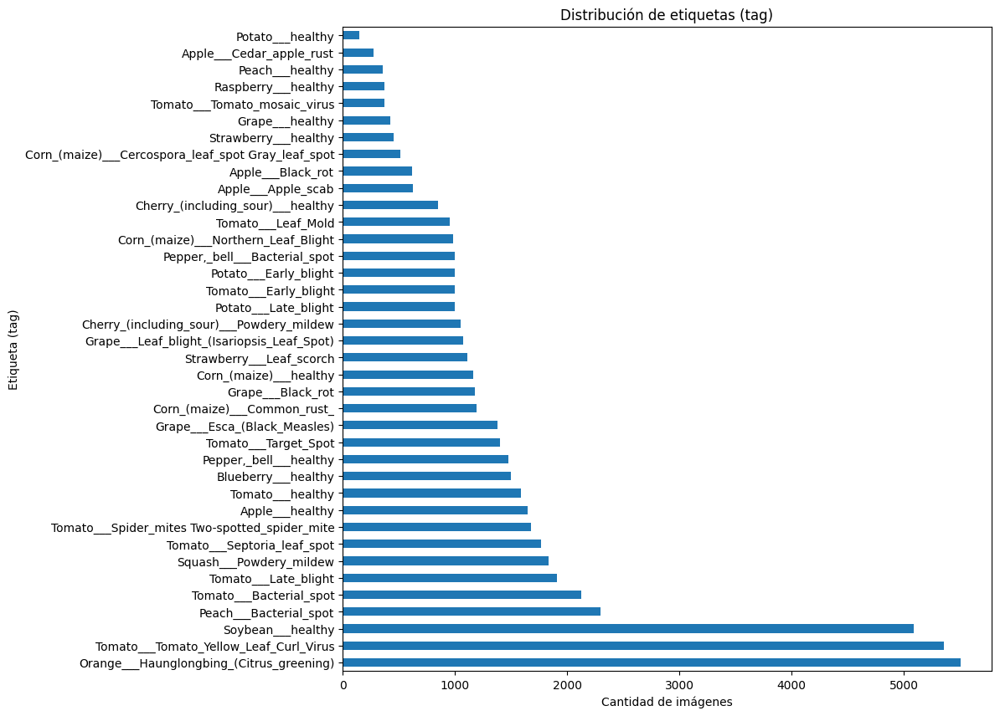

In [ ]:
df['class'].value_counts().plot(kind='barh', figsize=(10, 10))
plt.title('Distribución de etiquetas (tag)')
plt.xlabel('Cantidad de imágenes')
plt.ylabel('Etiqueta (tag)')
plt.show()

In [ ]:
# Verificamos la importación
df.sample(5)

,image_path,filename,class,group,tag
id,,,,,
34595,Blueberry___healthy/,831eb779-cdaf-4b95-9a7c-f8426008ac2b___RS_HL 5...,Blueberry___healthy,Blueberry,healthy
18016,Soybean___healthy/,4aaeceda-af99-4245-b82c-2ad467bf5c78___RS_HL 3...,Soybean___healthy,Soybean,healthy
52919,Tomato___Septoria_leaf_spot/,c06b05f0-b428-45ee-bc9f-df042d171e81___JR_Sept...,Tomato___Septoria_leaf_spot,Tomato,Septoria_leaf_spot
34471,Blueberry___healthy/,52a9109b-6022-498a-bb69-1f532f1de63c___RS_HL 5...,Blueberry___healthy,Blueberry,healthy
42421,Grape___Black_rot/,90fcfd87-aef9-458d-a15b-8385f40ea076___FAM_B.R...,Grape___Black_rot,Grape,Black_rot


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 54305 entries, 0 to 54304
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  54305 non-null  object
 1   filename    54305 non-null  object
 2   class       54305 non-null  object
 3   group       54305 non-null  object
 4   tag         54305 non-null  object
dtypes: object(5)
memory usage: 2.5+ MB


In [ ]:
df.describe()

,image_path,filename,class,group,tag
count,54305,54305,54305,54305,54305
unique,38,54305,38,14,21
top,Orange___Haunglongbing_(Citrus_greening)/,db32f3c2-3aa7-4ee8-abb1-9ee4ef325b5e___JR_HL 4...,Orange___Haunglongbing_(Citrus_greening),Tomato,healthy
freq,5507,1,5507,18160,15084


In [ ]:
import shutil
import os
import yaml
import pandas as pd
from PIL import Image

In [ ]:
# Carga de imagenes en memoria y visualización
def load_image(data: pd.DataFrame, index: int, root: str):
    """
    Carga una imagen PIL desde una fila específica de un DataFrame.

    Args:
        dataframe (pandas.DataFrame): El DataFrame que contiene las rutas de las imágenes.
        index (int): El índice de la fila en el DataFrame para cargar la imagen.
        root_dir (str): El directorio raíz donde se encuentran las imágenes.

    Returns:
        PIL.Image.Image: La imagen cargada como un objeto PIL.Image, o None si ocurre un error.
    """

    # if index < 0 or index >= len(data):
    #     print("Índice fuera de rango.")
    #     return None

    row = data.iloc[index]
    relative_path = row['image_path']
    filename = row['filename']
    full_path = os.path.join(root, relative_path, filename)

    try:
        img = Image.open(full_path)
        return img
    except FileNotFoundError:
        print(f"Archivo no encontrado: {full_path}")
        return None
    except Exception as e:
        print(f"Error al cargar la imagen: {e}")
        return None

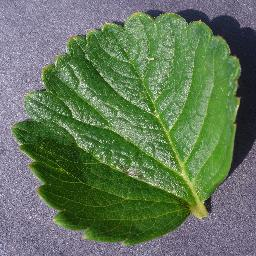

In [ ]:
# Permite visualizar una imagen específica (con iloc)
id = 0 # Indice de la imagen a cargar
image = load_image(data=df, index=id, root=ROOT_DIR)

#image.show() #popup option
image

Visualizando 10 imágenes aleatorias:
Imagen #1 (Índice: 33394):


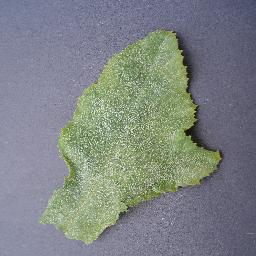

Imagen #2 (Índice: 15691):


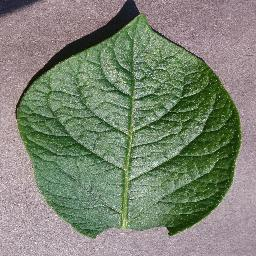

Imagen #3 (Índice: 34279):


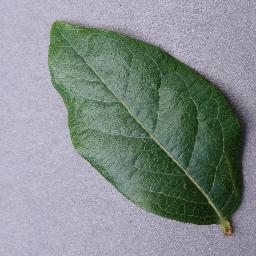

Imagen #4 (Índice: 6350):


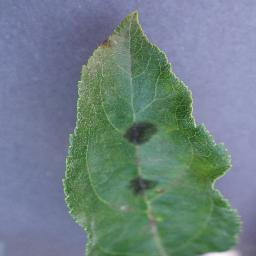

Imagen #5 (Índice: 19018):


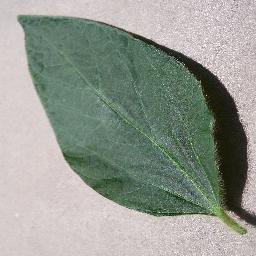

Imagen #6 (Índice: 26299):


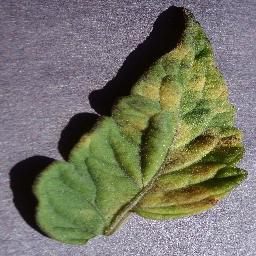

Imagen #7 (Índice: 16386):


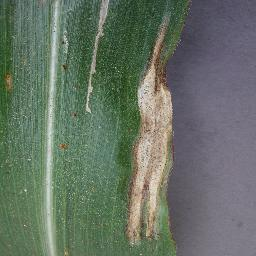

Imagen #8 (Índice: 15699):


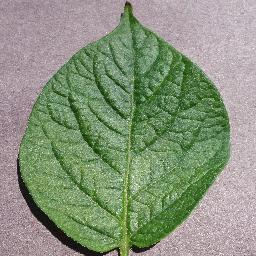

Imagen #9 (Índice: 7158):


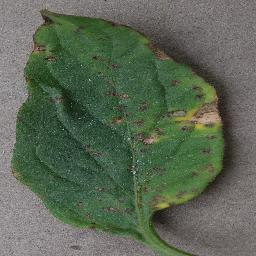

Imagen #10 (Índice: 21318):


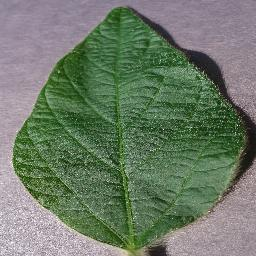

In [ ]:
# Obtener 10 índices aleatorios del DataFrame
num_to_display = 10
random_indices = random.sample(range(len(df)), num_to_display)

print(f"Visualizando {num_to_display} imágenes aleatorias:")
for i, index in enumerate(random_indices):
    try:
        image = load_image(data=df, index=index, root=ROOT_DIR)
        print(f"Imagen #{i+1} (Índice: {index}):")
        display(image) # Muestra la imagen directamente en entornos como Jupyter Notebook
    except FileNotFoundError:
        print(f"Error: No se encontró la imagen en la ruta: {os.path.join(ROOT_DIR, df.loc[index, 'relative_path'])}")
    except Exception as e:
        print(f"Error al cargar la imagen en el índice {index}: {e}")

In [ ]:
import seaborn as sns

In [ ]:
def plot_distribution(df, field, plot_type='bar', top_n=None, filter_by=None, ax=None, **kwargs):
    """
    Plots the distribution of values in a given field from a DataFrame on a given Axes object.

    Parameters:
    - df: pandas DataFrame
    - field: column name to group by (e.g., 'class', 'group', 'tag')
    - plot_type: 'bar' for bar chart, 'pie' for pie chart (default: 'bar')
    - top_n: if specified, shows only top N most frequent values
    - filter_by: dict to filter rows before plotting. Example: {'group': 'Tomato'}
    - ax: matplotlib Axes object to plot on. If None, a new figure and axes are created.
    - **kwargs: additional keyword arguments passed to matplotlib or seaborn plotting functions.
               For example, `autopct='%1.1f%%'` for pie charts, `palette` for both.
    """
    filtered_df = df.copy()

    # Apply filtering if specified
    if filter_by:
        for key, value in filter_by.items():
            filtered_df = filtered_df[filtered_df[key] == value]

    # Get value counts for the selected field
    value_counts = filtered_df[field].value_counts()

    if top_n:
        value_counts = value_counts.head(top_n)

    title_suffix = f" (filtered: {filter_by})" if filter_by else ""

    if ax is None:
        fig, ax = plt.subplots(figsize=(12, 6))

    if plot_type == 'bar':
        sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette=kwargs.get('palette', "viridis"))
        ax.set_title(f'Distribution per {field}{title_suffix}', fontsize=14)
        ax.set_xlabel(field, fontsize=14)
        ax.set_ylabel('Count', fontsize=14)
        ax.tick_params(axis='x', rotation=45, labelsize=12)
        ax.set_xticklabels(ax.get_xticklabels(), ha='right') # Set horizontal alignment here
        ax.tick_params(axis='y', labelsize=12)
    elif plot_type == 'pie':
        ax.pie(value_counts, labels=value_counts.index, startangle=140, **kwargs)
        ax.set_title(f'Distribution of {field}{title_suffix}', fontsize=14)
        ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    else:
        raise ValueError(f"Invalid plot_type: '{plot_type}'. Choose 'bar' or 'pie'.")

    if ax is None:
        plt.tight_layout()
        plt.show()

def plot_density_distribution(df, target):
    df_graph = df.copy()

    # Calculate value counts and order them
    ordered_classes = df_graph[target].value_counts().index

    # Map categorical target values to numeric indices
    df_graph['numeric_target'] = df_graph[target].map({cls: idx for idx, cls in enumerate(ordered_classes)})

    plt.figure(figsize=(15, 10))

    sns.histplot(data=df_graph, x='numeric_target', hue='numeric_target', discrete=True, stat='density', label='Histogram', palette="viridis", legend=False)
    sns.kdeplot(data=df_graph, x='numeric_target', label='Density Plot', color='orange', linewidth=2)
    plt.xticks(ticks=range(len(ordered_classes)), labels=ordered_classes, rotation=45, ha='right', va='top')
    plt.title(f"Histogram and Density plot of '{target}' distribution")
    plt.xlabel("")
    plt.ylabel("Density")
    plt.legend(labels=["Histogram", "Density Plot"])

    plt.tight_layout()
    plt.show()

In [ ]:
import warnings
warnings.filterwarnings('ignore')

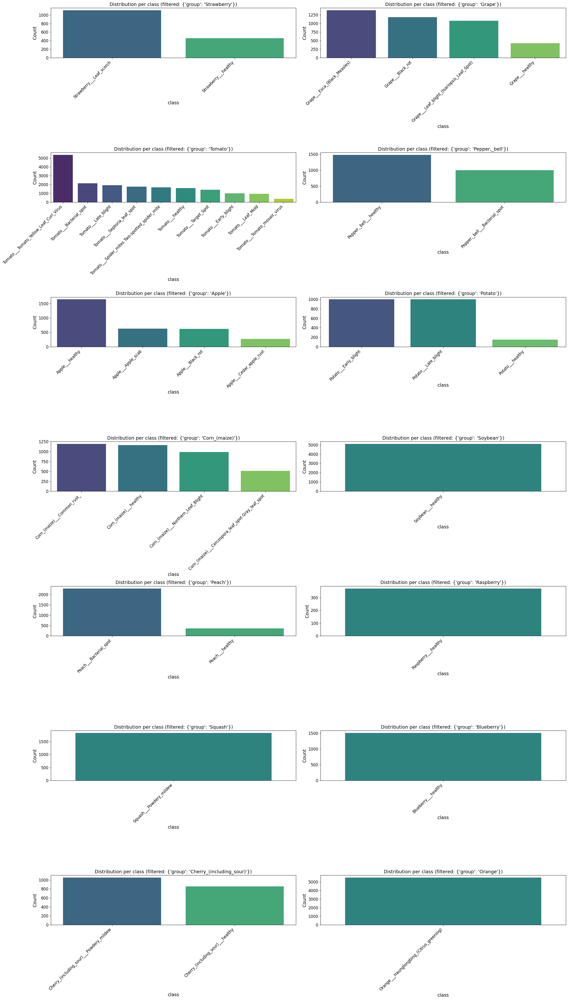

In [ ]:
# Implementing grid logic outside the function:
unique_groups = df['group'].unique()
num_groups = len(unique_groups)
grid_cols = 2
num_rows = math.ceil(num_groups / grid_cols)
fig, axes = plt.subplots(num_rows, grid_cols, figsize=(12 * grid_cols, 6 * num_rows))
axes = axes.flatten() # Flatten the axes array for easy indexing
for i, group in enumerate(unique_groups):
    if i < len(axes):
        plot_distribution(df, field='class', filter_by={'group': group},
                          ax=axes[i], plot_type='bar')

# Hide any unused subplots
for j in range(num_groups, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
### Resumen distribucion por grupo
print("Conteo por grupo:")
print(df['group'].value_counts())

Conteo por grupo:
group
Tomato                     18160
Orange                      5507
Soybean                     5090
Grape                       4062
Corn_(maize)                3852
Apple                       3171
Peach                       2657
Pepper,_bell                2475
Potato                      2152
Cherry_(including_sour)     1906
Squash                      1835
Strawberry                  1565
Blueberry                   1502
Raspberry                    371
Name: count, dtype: int64


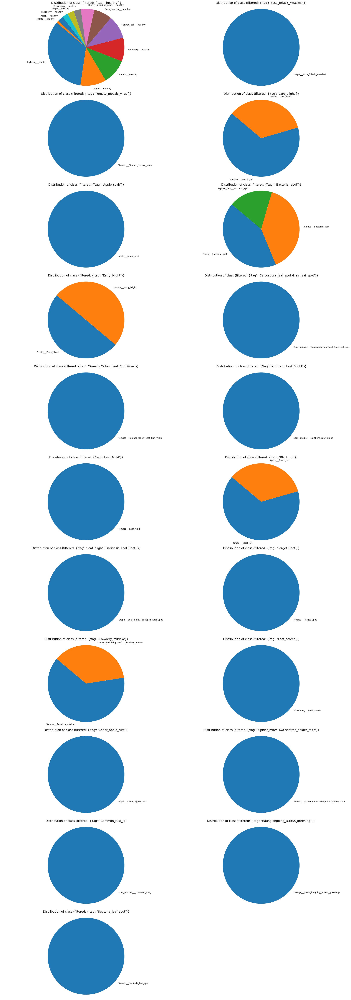

In [ ]:
# Implementing grid logic outside the function:
unique_tags = df['tag'].unique()
num_tags = len(unique_tags)
grid_cols = 2
num_rows = math.ceil(num_tags / grid_cols)
fig, axes = plt.subplots(num_rows, grid_cols, figsize=(12 * grid_cols, 6 * num_rows))
axes = axes.flatten() # Flatten the axes array for easy indexing
for i, tag in enumerate(unique_tags):
    if i < len(axes):
        plot_distribution(df, field='class', filter_by={'tag': tag},
                          ax=axes[i], plot_type='pie')

# Hide any unused subplots
for j in range(num_tags, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
## Resumen distribucion por enfermedad
print("Conteo por enfermedad:")
print(df['tag'].value_counts())

Conteo por enfermedad:
tag
healthy                                 15084
Haunglongbing_(Citrus_greening)          5507
Bacterial_spot                           5421
Tomato_Yellow_Leaf_Curl_Virus            5357
Late_blight                              2909
Powdery_mildew                           2887
Early_blight                             2000
Black_rot                                1801
Septoria_leaf_spot                       1771
Spider_mites Two-spotted_spider_mite     1676
Target_Spot                              1404
Esca_(Black_Measles)                     1383
Common_rust_                             1192
Leaf_scorch                              1109
Leaf_blight_(Isariopsis_Leaf_Spot)       1076
Northern_Leaf_Blight                      985
Leaf_Mold                                 952
Apple_scab                                630
Cercospora_leaf_spot Gray_leaf_spot       513
Tomato_mosaic_virus                       373
Cedar_apple_rust                          275
Name: c

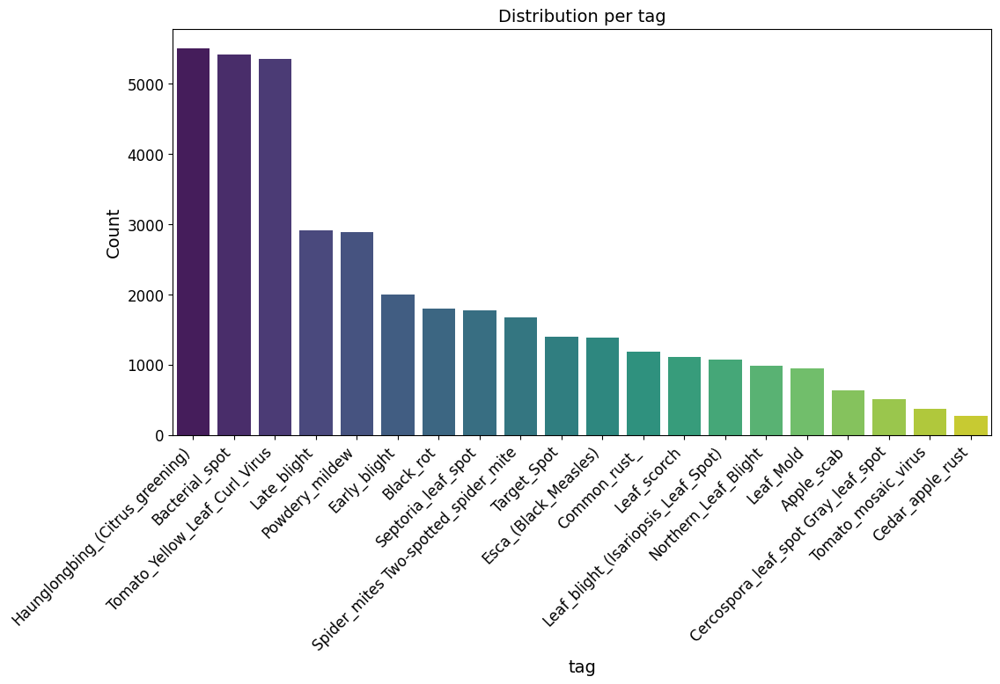

In [ ]:
# we execute plot_distribution grouping by tag, iterating throguh all the tags
plot_distribution(df[df['tag'] != 'healthy'], field='tag', top_n=40)

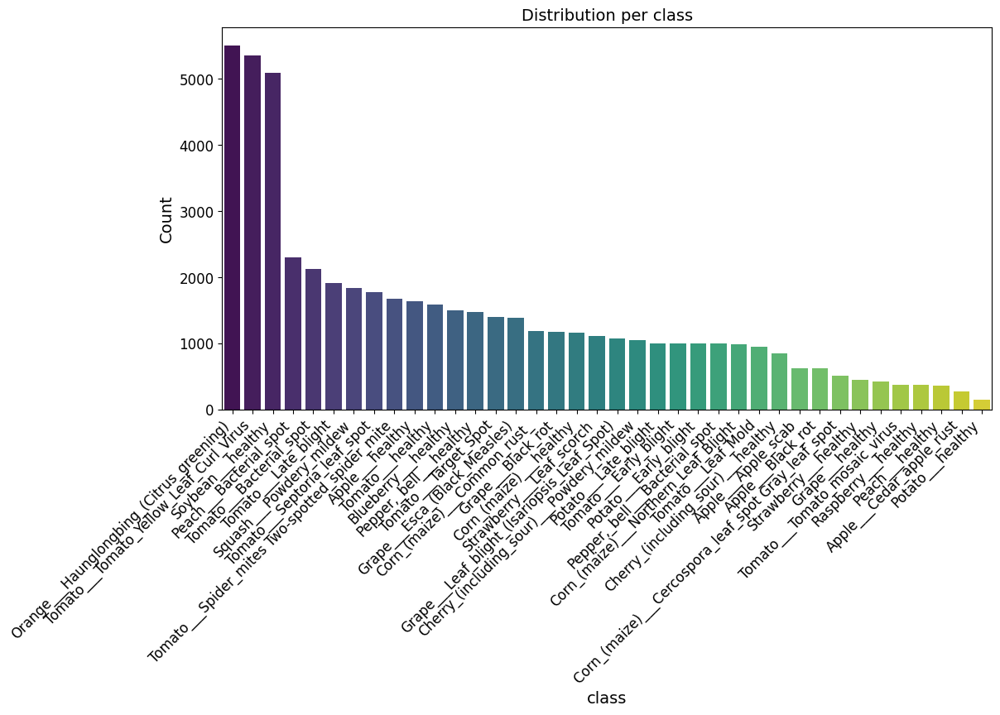

In [ ]:
# now using the previous function we plot th edistribution by class , group and tag
plot_distribution(df, field='class', top_n=40)

In [ ]:
## Distribución entre clases
print("Conteo por grupo:")
print(df['class'].value_counts())

Conteo por grupo:
class
Orange___Haunglongbing_(Citrus_greening)              5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus                5357
Soybean___healthy                                     5090
Peach___Bacterial_spot                                2297
Tomato___Bacterial_spot                               2127
Tomato___Late_blight                                  1909
Squash___Powdery_mildew                               1835
Tomato___Septoria_leaf_spot                           1771
Tomato___Spider_mites Two-spotted_spider_mite         1676
Apple___healthy                                       1645
Tomato___healthy                                      1591
Blueberry___healthy                                   1502
Pepper,_bell___healthy                                1478
Tomato___Target_Spot                                  1404
Grape___Esca_(Black_Measles)                          1383
Corn_(maize)___Common_rust_                           1192
Grape___Black_rot               

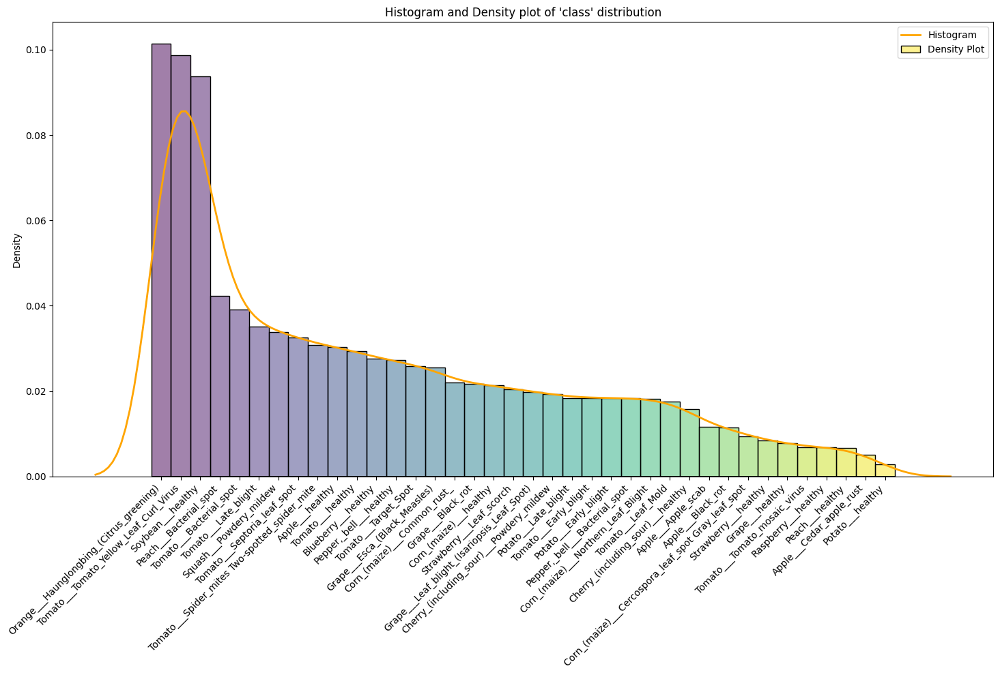

In [ ]:
plot_density_distribution(df, target='class')

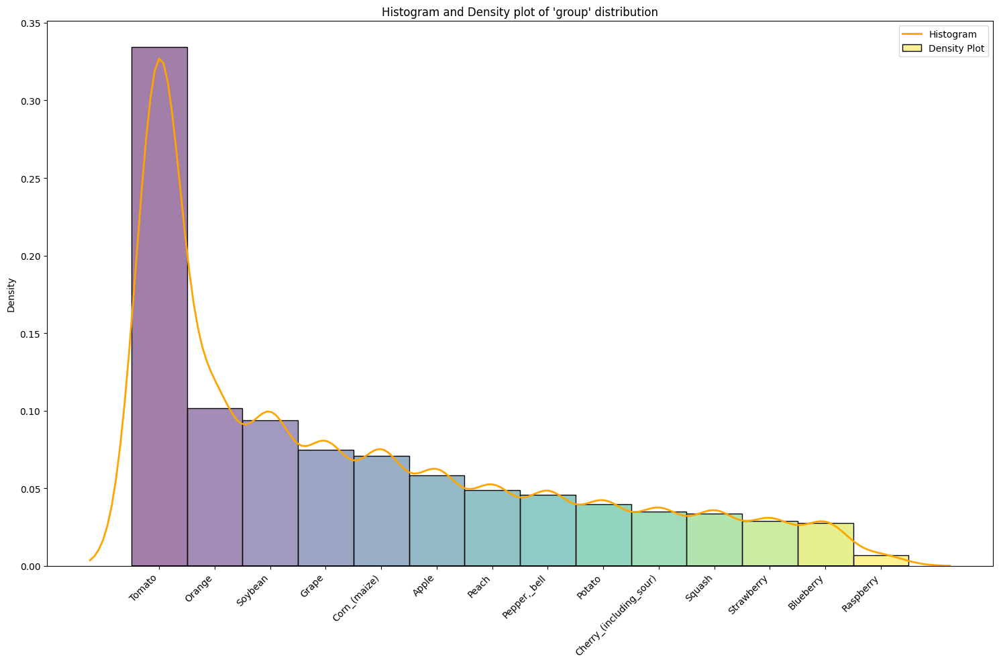

In [ ]:
plot_density_distribution(df, target='group')

## Firmas espectrales en RGB

In [ ]:
df.sample(5)

,image_path,filename,class,group,tag
id,,,,,
7299,Tomato___Bacterial_spot/,613d2aaf-3f77-498f-abf2-8519cc595bbe___GCREC_B...,Tomato___Bacterial_spot,Tomato,Bacterial_spot
22807,Peach___Bacterial_spot/,0dc25e13-196a-4a79-a176-c7aeaa17a8d8___Rutg._B...,Peach___Bacterial_spot,Peach,Bacterial_spot
13830,Tomato___Tomato_Yellow_Leaf_Curl_Virus/,329b304a-e702-452d-9c51-8d037841bdd6___YLCV_NR...,Tomato___Tomato_Yellow_Leaf_Curl_Virus,Tomato,Tomato_Yellow_Leaf_Curl_Virus
46138,Orange___Haunglongbing_(Citrus_greening)/,9bee4f4b-c03d-4474-a91d-ae7f33edb2d8___UF.Citr...,Orange___Haunglongbing_(Citrus_greening),Orange,Haunglongbing_(Citrus_greening)
15601,Tomato___Tomato_Yellow_Leaf_Curl_Virus/,50c3799c-1ee9-4c5f-ba71-0b7cc82a9b9f___YLCV_GC...,Tomato___Tomato_Yellow_Leaf_Curl_Virus,Tomato,Tomato_Yellow_Leaf_Curl_Virus


In [ ]:
def compute_average_rgb_histograms(df: pd.DataFrame, root_dir: str, bins: int = 256, max_images_per_group_tag: int = None):
    """
    Calcula el histograma promedio por canal RGB para cada combinación única de (group, tag).

    Args:
        df (pd.DataFrame): DataFrame que contiene las columnas 'image_path', 'filename', 'group', 'tag'.
        root_dir (str): Directorio raíz donde están almacenadas las imágenes.
        bins (int): Número de bins para el histograma (por defecto 256).
        max_images_per_group_tag (int): Máximo de imágenes a procesar por grupo/tag. Si None, se procesan todas.

    Returns:
        pd.DataFrame: Un DataFrame con las columnas [group, tag, bin, r, g, b].
    """
    from collections import defaultdict
    import numpy as np
    from PIL import Image
    import os

    def load_image(row, root):
        full_path = os.path.join(root, row['image_path'], row['filename'])
        try:
            return Image.open(full_path).convert("RGB")
        except Exception:
            return None

    def calculate_rgb_histogram(image, bins):
        arr = np.array(image)
        hist_r, _ = np.histogram(arr[:, :, 0], bins=bins, range=(0, 256))
        hist_g, _ = np.histogram(arr[:, :, 1], bins=bins, range=(0, 256))
        hist_b, _ = np.histogram(arr[:, :, 2], bins=bins, range=(0, 256))
        return hist_r, hist_g, hist_b

    grouped = df.groupby(["group", "tag"])
    histograms = defaultdict(lambda: {'r': [], 'g': [], 'b': []})

    for (group, tag), group_df in grouped:
        count = 0
        for _, row in group_df.iterrows():
            if max_images_per_group_tag and count >= max_images_per_group_tag:
                break
            img = load_image(row, root_dir)
            if img is not None:
                hr, hg, hb = calculate_rgb_histogram(img, bins)
                histograms[(group, tag)]['r'].append(hr)
                histograms[(group, tag)]['g'].append(hg)
                histograms[(group, tag)]['b'].append(hb)
                count += 1

    # Promediar los histogramas
    result_data = []
    for (group, tag), hists in histograms.items():
        r_avg = np.mean(hists['r'], axis=0)
        g_avg = np.mean(hists['g'], axis=0)
        b_avg = np.mean(hists['b'], axis=0)
        for i in range(bins):
            result_data.append({
                "group": group,
                "tag": tag,
                "bin": i,
                "r": r_avg[i],
                "g": g_avg[i],
                "b": b_avg[i],
            })

    return pd.DataFrame(result_data)


In [ ]:
df

,image_path,filename,class,group,tag
id,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy
...,...,...,...,...,...
54300,Cherry_(including_sour)___healthy/,77835532-af02-44be-aaac-fa36f9fa5d7a___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy
54301,Cherry_(including_sour)___healthy/,9705f45b-e0e3-4d0e-a0f0-ad1c9b3b32a0___JR_HL 4...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy
54302,Cherry_(including_sour)___healthy/,7d779a1c-5d0c-4a30-ba07-b2c456b11797___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy


In [ ]:
df["label_binaria"] = df["tag"].apply(lambda x: 0 if x.lower() == "healthy" else 1)

In [ ]:
df

,image_path,filename,class,group,tag,label_binaria
id,,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy,0
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0
...,...,...,...,...,...,...
54300,Cherry_(including_sour)___healthy/,77835532-af02-44be-aaac-fa36f9fa5d7a___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0
54301,Cherry_(including_sour)___healthy/,9705f45b-e0e3-4d0e-a0f0-ad1c9b3b32a0___JR_HL 4...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0
54302,Cherry_(including_sour)___healthy/,7d779a1c-5d0c-4a30-ba07-b2c456b11797___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0


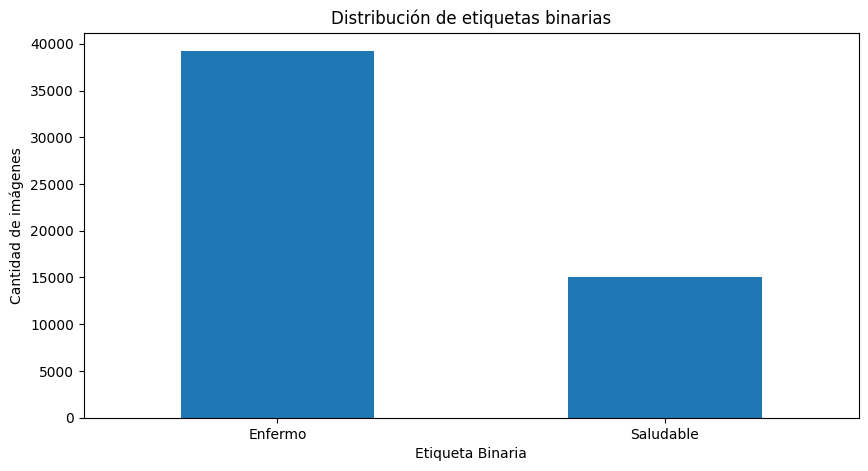

In [ ]:
df['label_binaria'].value_counts().plot(kind='bar', figsize=(10, 5))
plt.title('Distribución de etiquetas binarias')
plt.xlabel('Etiqueta Binaria')
plt.ylabel('Cantidad de imágenes')
plt.xticks(ticks=[0, 1], labels=['Enfermo', 'Saludable'], rotation=0)
plt.show()

In [ ]:
import numpy as np

In [ ]:
# Paso 1: Definir el path base (verificando cómo se compone la ruta desde el dataframe)
def build_image_path(row):
    return os.path.join(ROOT_DIR, row["image_path"], row["filename"])

df["full_path"] = df.apply(build_image_path, axis=1)

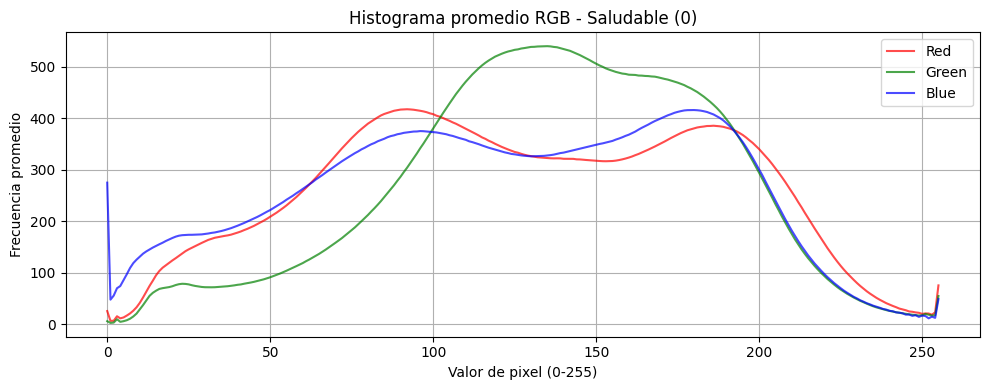

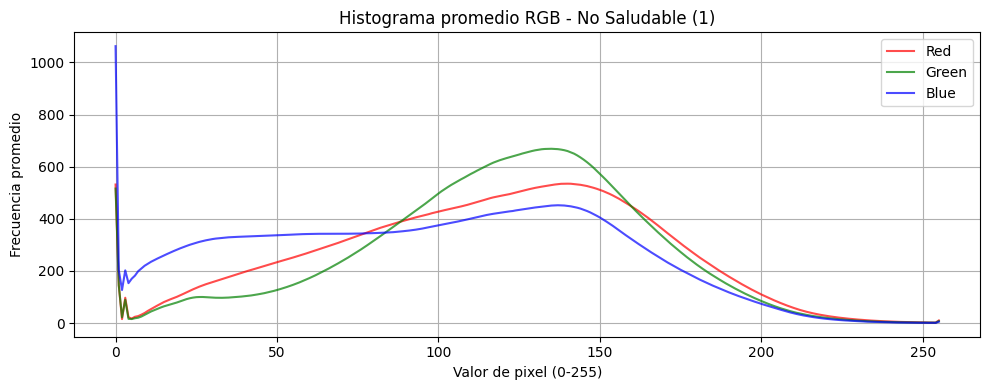

In [ ]:
# Paso 3: Agrupar por label_binaria
grouped = df.groupby("label_binaria")

# Paso 4: Calcular histogramas promedio por clase binaria
average_histograms = {}

for label, group_df in grouped:
    hist_r_total = np.zeros(256)
    hist_g_total = np.zeros(256)
    hist_b_total = np.zeros(256)
    count = 0

    for path in group_df["full_path"]:
        try:
            img = Image.open(path).convert("RGB")
            arr = np.array(img)
            hist_r, _ = np.histogram(arr[:, :, 0], bins=256, range=(0, 256))
            hist_g, _ = np.histogram(arr[:, :, 1], bins=256, range=(0, 256))
            hist_b, _ = np.histogram(arr[:, :, 2], bins=256, range=(0, 256))
            hist_r_total += hist_r
            hist_g_total += hist_g
            hist_b_total += hist_b
            count += 1
        except Exception:
            continue

    if count > 0:
        avg_r = hist_r_total / count
        avg_g = hist_g_total / count
        avg_b = hist_b_total / count
        average_histograms[label] = (avg_r, avg_g, avg_b)

# Paso 5: Graficar con colores RGB
for label, (avg_r, avg_g, avg_b) in average_histograms.items():
    etiqueta = "Saludable (0)" if label == 0 else "No Saludable (1)"
    plt.figure(figsize=(10, 4))
    plt.title(f"Histograma promedio RGB - {etiqueta}")
    plt.plot(avg_r, label="Red", color='red', alpha=0.7)
    plt.plot(avg_g, label="Green", color='green', alpha=0.7)
    plt.plot(avg_b, label="Blue", color='blue', alpha=0.7)
    plt.xlabel("Valor de pixel (0-255)")
    plt.ylabel("Frecuencia promedio")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import os

## Split dataset

In [ ]:
def split_data(df,
               target_column='class',
               test_size=0.20,
               validation_size=0.0, # Por defecto no define un conjunto de validación
               random_state=42,     # Semilla para reproducibilidad
               split_column_name='split'):
    """
    Añade una columna al DataFrame indicando la división (train/test/validation).

    Realiza una división estratificada para mantener el balance de clases.

    Args:
        df (pd.DataFrame): DataFrame de entrada con al menos la columna 'target_column'.
        target_column (str): Nombre de la columna que contiene las etiquetas de clase
                             para la estratificación (ej: 'class').
        test_size (float): Proporción del dataset a incluir en el conjunto de test (ej: 0.20).
        validation_size (float): Proporción del dataset a incluir en el conjunto de validación.
                                 La proporción de entrenamiento será 1.0 - test_size - validation_size.
                                 Si es 0.0, solo se crearán conjuntos de train y test.
        random_state (int): Semilla para el generador de números aleatorios para asegurar
                            divisiones reproducibles.
        split_column_name (str): Nombre de la nueva columna que contendrá las etiquetas
                                 'train', 'test' o 'validation'.

    Returns:
        pd.DataFrame: El DataFrame original con la nueva columna 'split_column_name'.

    Raises:
        ValueError: Si test_size + validation_size >= 1.0, o si target_column no existe.
        ImportError: Si scikit-learn no está instalado.
    """
    if target_column not in df.columns:
        raise ValueError(f"La columna objetivo '{target_column}' no se encuentra en el DataFrame.")

    if not isinstance(test_size, float) or not (0.0 <= test_size < 1.0):
         raise ValueError("test_size debe ser un float entre 0.0 y 1.0.")

    if not isinstance(validation_size, float) or not (0.0 <= validation_size < 1.0):
         raise ValueError("validation_size debe ser un float entre 0.0 y 1.0.")

    if test_size + validation_size >= 1.0:
        raise ValueError("La suma de test_size y validation_size debe ser menor que 1.0.")

    # Crear la nueva columna inicializada (opcional, pero ayuda a la claridad)
    df[split_column_name] = 'unassigned'

    # Extraer etiquetas para estratificación
    labels = df[target_column]
    indices = df.index # Usaremos los índices para la división

    # --- Lógica de División ---

    # Caso 1: División en Train / Test (sin Validación)
    if validation_size == 0.0:
        train_indices, test_indices = train_test_split(
            indices,
            test_size=test_size,
            random_state=random_state,
            stratify=labels # Permite mantener el balance de clases
        )
        df.loc[train_indices, split_column_name] = 'train'
        df.loc[test_indices, split_column_name] = 'test'
        logging.info(f"División completada: Train ({1-test_size:.1%}), Test ({test_size:.1%}). Estratificada por '{target_column}'.")

    # Caso 2: División en Train / Test / Validation
    else:
        # Paso 1: Dividir en (Train + Validation) y Test
        remaining_indices, test_indices = train_test_split(
            indices,
            test_size=test_size, # Tamaño final del conjunto de test
            random_state=random_state,
            stratify=labels
        )

        # Calcular el tamaño relativo de validación respecto al conjunto restante (Train + Validation)
        # Ejemplo: test=0.2, val=0.1 -> Total 0.3. Restante 0.7. val_rel = 0.1 / 0.7 = 0.142...
        # train_test_split tomará el 14.2% del 70% restante, lo que equivale al 10% del total original.
        relative_val_size = validation_size / (1.0 - test_size)

        # Obtener las etiquetas correspondientes SOLO al conjunto restante para la segunda estratificación
        remaining_labels = df.loc[remaining_indices, target_column]

        # Paso 2: Dividir el conjunto restante en Train y Validation
        train_indices, validation_indices = train_test_split(
            remaining_indices, # Dividir solo los índices restantes
            test_size=relative_val_size, # Tamaño relativo calculado
            random_state=random_state,   # Usar la misma semilla para consistencia
            stratify=remaining_labels    # Estratificar usando las etiquetas restantes
        )

        # Asignar etiquetas de división al DataFrame original
        df.loc[train_indices, split_column_name] = 'train'
        df.loc[validation_indices, split_column_name] = 'valid'
        df.loc[test_indices, split_column_name] = 'test'

        train_actual_prop = len(train_indices) / len(df)
        val_actual_prop = len(validation_indices) / len(df)
        test_actual_prop = len(test_indices) / len(df)
        logging.info(f"División completada: Train ({train_actual_prop:.1%}), Validation ({val_actual_prop:.1%}), Test ({test_actual_prop:.1%}). Estratificada por '{target_column}'.")

    return df

In [ ]:
df_split = split_data(df.copy(), # Usar .copy() para no modificar el original directamente aquí
                                target_column='class',
                                test_size=0.2,
                                random_state=42) # Usa la semilla que prefieras

In [ ]:
df_split

,image_path,filename,class,group,tag,label_binaria,full_path,split
id,,,,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/a32f...,train
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/70c3...,test
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/328c...,train
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/2e75...,train
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/4f28...,train
...,...,...,...,...,...,...,...,...
54300,Cherry_(including_sour)___healthy/,77835532-af02-44be-aaac-fa36f9fa5d7a___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train
54301,Cherry_(including_sour)___healthy/,9705f45b-e0e3-4d0e-a0f0-ad1c9b3b32a0___JR_HL 4...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train
54302,Cherry_(including_sour)___healthy/,7d779a1c-5d0c-4a30-ba07-b2c456b11797___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train


In [ ]:
df_split['split'].value_counts()

,count
split,
train,43444
test,10861


In [ ]:
# Guardamos el dataframe como .CSV para evitar realizar este proceso nuevamente
df_split.to_csv('dataframe_splitted.csv')

In [ ]:
print("\n--- Conteo de muestras por 'split' ---")
print(df_split['split'].value_counts(normalize=True)) # normalize=True muestra proporciones

print("\n--- Verificación del Balance de Clases por 'split' ---")

# Comprobar si las proporciones de clases son similares en cada split
print(df_split.groupby('split')['class'].value_counts(normalize=True))


--- Conteo de muestras por 'split' ---
split
train    0.8
test     0.2
Name: proportion, dtype: float64

--- Verificación del Balance de Clases por 'split' ---
split  class                                   
test   Orange___Haunglongbing_(Citrus_greening)    0.101464
       Tomato___Tomato_Yellow_Leaf_Curl_Virus      0.098610
       Soybean___healthy                           0.093730
       Peach___Bacterial_spot                      0.042353
       Tomato___Bacterial_spot                     0.039131
                                                     ...   
train  Tomato___Tomato_mosaic_virus                0.006859
       Raspberry___healthy                         0.006836
       Peach___healthy                             0.006629
       Apple___Cedar_apple_rust                    0.005064
       Potato___healthy                            0.002808
Name: proportion, Length: 76, dtype: float64


In [ ]:
df.head()

,image_path,filename,class,group,tag,label_binaria,full_path
id,,,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/a32f...
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/70c3...
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/328c...
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/2e75...
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/4f28...


## Construccion de Carpetas para Pytorch

In [ ]:
import os
import shutil
from tqdm import tqdm

In [ ]:
def reorganize_dataset_multiclass(df, split_column, label_column, full_path_column, base_output_dir):
    """
    Reorganiza el dataset en formato ImageFolder para clasificación multiclase.

    Args:
        df (pd.DataFrame): DataFrame con información de las imágenes.
        split_column (str): Columna que indica el conjunto ('train', 'val', 'test', etc.).
        label_column (str): Columna con la clase (nombre de clase como string).
        full_path_column (str): Columna con la ruta completa a la imagen.
        base_output_dir (str): Carpeta base de salida (e.g., "./dataset/")
    """
    splits = df[split_column].unique()
    clases = df[label_column].unique()

    for split in splits:
        df_split = df[df[split_column] == split]

        # Crear carpetas para cada clase dentro del split
        for class_name in clases:
            class_dir = os.path.join(base_output_dir, split, str(class_name))
            os.makedirs(class_dir, exist_ok=True)

        print(f"Procesando split: {split}")
        for _, row in tqdm(df_split.iterrows(), total=len(df_split)):
            label = row[label_column]
            src = row[full_path_column]
            dst = os.path.join(base_output_dir, split, str(label), os.path.basename(src))
            try:
                shutil.copy2(src, dst)
            except Exception as e:
                print(f"Error al copiar: {src} -> {dst}\n{e}")


In [ ]:
df_split

,image_path,filename,class,group,tag,label_binaria,full_path,split
id,,,,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/a32f...,train
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/70c3...,test
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/328c...,train
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/2e75...,train
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/4f28...,train
...,...,...,...,...,...,...,...,...
54300,Cherry_(including_sour)___healthy/,77835532-af02-44be-aaac-fa36f9fa5d7a___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train
54301,Cherry_(including_sour)___healthy/,9705f45b-e0e3-4d0e-a0f0-ad1c9b3b32a0___JR_HL 4...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train
54302,Cherry_(including_sour)___healthy/,7d779a1c-5d0c-4a30-ba07-b2c456b11797___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train


In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_split['label'] = le.fit_transform(df['class'])

In [ ]:
df_split

,image_path,filename,class,group,tag,label_binaria,full_path,split,label
id,,,,,,,,,
0,Strawberry___healthy/,a32f24fa-91ce-42dd-b786-5e4ed4f2d037___RS_HL 4...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/a32f...,train,27
1,Strawberry___healthy/,70c3ebc3-9917-4ed7-920b-e83719e6c414___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/70c3...,test,27
2,Strawberry___healthy/,328cd6a7-46a5-4beb-8b62-b68db500a830___RS_HL 1...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/328c...,train,27
3,Strawberry___healthy/,2e75a60a-af82-45cf-abe0-1d13d63dc6fa___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/2e75...,train,27
4,Strawberry___healthy/,4f288160-7226-425e-afe7-826fb19af650___RS_HL 2...,Strawberry___healthy,Strawberry,healthy,0,/content/color/color/Strawberry___healthy/4f28...,train,27
...,...,...,...,...,...,...,...,...,...
54300,Cherry_(including_sour)___healthy/,77835532-af02-44be-aaac-fa36f9fa5d7a___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train,6
54301,Cherry_(including_sour)___healthy/,9705f45b-e0e3-4d0e-a0f0-ad1c9b3b32a0___JR_HL 4...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train,6
54302,Cherry_(including_sour)___healthy/,7d779a1c-5d0c-4a30-ba07-b2c456b11797___JR_HL 9...,Cherry_(including_sour)___healthy,Cherry_(including_sour),healthy,0,/content/color/color/Cherry_(including_sour)__...,train,6


In [ ]:
#!rm -rf splitted/

In [ ]:
reorganize_dataset_multiclass(
    df=df_split,
    split_column="split",
    label_column="label",
    full_path_column='full_path',
    base_output_dir='splitted/'
)

Procesando split: train


100%|██████████| 43444/43444 [00:09<00:00, 4669.59it/s]


Procesando split: test


100%|██████████| 10861/10861 [00:02<00:00, 4530.90it/s]


In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
def mostrar_imagenes_por_clase(carpeta_base, split="train", cantidad=5, idx_to_label=None):
    """
    Muestra imágenes aleatorias por clase del dataset organizado en formato ImageFolder.

    Args:
        carpeta_base (str): Ruta base donde están los splits.
        split (str): Subcarpeta ('train', 'test', etc.).
        cantidad (int): Cantidad de imágenes por clase a mostrar.
        idx_to_label (dict): Diccionario opcional para traducir nombres de carpeta (índices) a nombres reales de clase.
    """
    carpeta_split = os.path.join(carpeta_base, split)
    clases = sorted([d for d in os.listdir(carpeta_split) if os.path.isdir(os.path.join(carpeta_split, d))])

    fig, axes = plt.subplots(len(clases), cantidad, figsize=(cantidad * 3, len(clases) * 3))
    if len(clases) == 1:
        axes = [axes]  # asegurar estructura uniforme

    for i, clase in enumerate(clases):
        nombre_real = idx_to_label[int(clase)] if idx_to_label else clase
        carpeta_clase = os.path.join(carpeta_split, clase)
        imagenes = [f for f in os.listdir(carpeta_clase) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        seleccionadas = random.sample(imagenes, min(cantidad, len(imagenes)))

        for j, nombre_archivo in enumerate(seleccionadas):
            ruta = os.path.join(carpeta_clase, nombre_archivo)
            img = Image.open(ruta).convert("RGB")
            if len(clases) == 1:
                axes[j].imshow(img)
                axes[j].axis('off')
                axes[j].set_title(f"{split} - {nombre_real}")
            else:
                axes[i][j].imshow(img)
                axes[i][j].axis('off')
                axes[i][j].set_title(f"{split} - {nombre_real}")

    plt.tight_layout()
    plt.show()






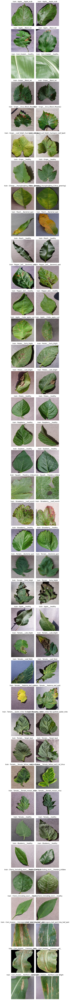

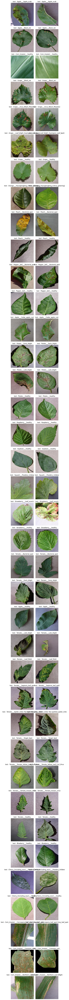

In [ ]:
idx_to_label = dict(enumerate(le.classes_))

# Llamar función
mostrar_imagenes_por_clase("./splitted", split="train", cantidad=2, idx_to_label=idx_to_label)
mostrar_imagenes_por_clase("./splitted", split="test", cantidad=2, idx_to_label=idx_to_label)


# Baseline

In [ ]:
#import gdown

# ID del archivo (extraído de la URL que compartiste)
#file_id = "177hx7RLSC6tQHaEdTsWEW5woSqSrRX3M"

# Construir la URL directa
#url = f"https://drive.google.com/uc?id={file_id}"

# Descargar
#gdown.download(url, output="splitted.zip", quiet=False)

In [ ]:
#import zipfile

#with zipfile.ZipFile("splitted.zip", 'r') as zip_ref:
#    zip_ref.extractall("splitted")

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

In [ ]:
# Evitar errores fantasma en CUDA
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

# Dispositivo
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Rutas
train_dir = './splitted/train'
test_dir = './splitted/test'

In [ ]:
# Transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5]*3, std=[0.5]*3)
])

# Cargar datasets
train_dataset = datasets.ImageFolder(train_dir, transform=transform)
test_dataset = datasets.ImageFolder(test_dir, transform=transform)

# Dataloaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Clases
class_names = train_dataset.classes
n_classes = len(class_names)
print("Clases detectadas:", class_names)

print(f"Número de clases: {n_classes}")
print(f"Clases: {train_dataset.classes}")

Clases detectadas: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Número de clases: 38
Clases: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

In [ ]:
class CNNMulticlase(nn.Module):
    def __init__(self, num_classes):
        super(CNNMulticlase, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.25)

        self.fc1 = nn.Linear(64 * 56 * 56, 128)  # después de dos poolings: 224→112→56
        self.fc2 = nn.Linear(128, num_classes)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))  # 224 → 112
        x = self.pool(F.relu(self.conv2(x)))  # 112 → 56
        x = self.dropout(x)
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        return self.fc2(x)  # logits



In [ ]:
from torchsummary import summary

In [ ]:
# Selección automática de dispositivo: prioriza CUDA, luego MPS, finalmente CPU
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("Usando GPU NVIDIA con CUDA")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Usando GPU Apple Silicon con MPS")
else:
    device = torch.device("cpu")
    print("Usando CPU")

Usando GPU NVIDIA con CUDA


In [ ]:
print("Clases detectadas:", train_dataset.classes)
print("Cantidad de clases:", n_classes)

Clases detectadas: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Cantidad de clases: 38


In [ ]:
all_labels = [label for _, label in train_dataset.samples]
print("Máxima etiqueta:", max(all_labels))
print("Mínima etiqueta:", min(all_labels))


Máxima etiqueta: 37
Mínima etiqueta: 0


In [ ]:
print("n_classes:", n_classes)
model_test = CNNMulticlase(num_classes=n_classes)
print("Modelo creado")

n_classes: 38
Modelo creado


In [ ]:
model = CNNMulticlase(num_classes=n_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-5)

In [ ]:
summary(model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
         MaxPool2d-2         [-1, 32, 112, 112]               0
            Conv2d-3         [-1, 64, 112, 112]          18,496
         MaxPool2d-4           [-1, 64, 56, 56]               0
           Dropout-5           [-1, 64, 56, 56]               0
            Linear-6                  [-1, 128]      25,690,240
            Linear-7                   [-1, 38]           4,902
Total params: 25,714,534
Trainable params: 25,714,534
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.57
Forward/backward pass size (MB): 24.50
Params size (MB): 98.09
Estimated Total Size (MB): 123.17
----------------------------------------------------------------


In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import accuracy_score

In [ ]:
from sklearn.metrics import accuracy_score

def train_and_evaluate(model, train_loader, test_loader, criterion, optimizer, device, epochs=5, class_names=None):
    history = {"train_loss": [], "test_loss": [], "train_acc": [], "test_acc": []}

    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        y_true_train, y_pred_train = [], []

        for x_batch, y_batch in train_loader:
            x_batch = x_batch.to(device)
            y_batch = y_batch.long().to(device)

            outputs = model(x_batch)  # logits
            loss = criterion(outputs, y_batch)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            preds = torch.argmax(outputs, dim=1)

            y_true_train.extend(y_batch.cpu().numpy())
            y_pred_train.extend(preds.cpu().numpy())

        train_acc = accuracy_score(y_true_train, y_pred_train)
        history["train_loss"].append(train_loss / len(train_loader))
        history["train_acc"].append(train_acc)

        # Evaluación
        model.eval()
        test_loss = 0.0
        y_true_test, y_pred_test = [], []

        with torch.no_grad():
            for x_batch, y_batch in test_loader:
                x_batch = x_batch.to(device)
                y_batch = y_batch.long().to(device)

                outputs = model(x_batch)
                loss = criterion(outputs, y_batch)
                test_loss += loss.item()

                preds = torch.argmax(outputs, dim=1)
                y_true_test.extend(y_batch.cpu().numpy())
                y_pred_test.extend(preds.cpu().numpy())

        test_acc = accuracy_score(y_true_test, y_pred_test)
        history["test_loss"].append(test_loss / len(test_loader))
        history["test_acc"].append(test_acc)

        print(f"Epoch {epoch+1}/{epochs} - Train Loss: {history['train_loss'][-1]:.4f} | Test Loss: {history['test_loss'][-1]:.4f} | Train Acc: {train_acc:.4f} | Test Acc: {test_acc:.4f}")

    return history


In [ ]:
import matplotlib.pyplot as plt

def plot_training_history(history):
    epochs = range(1, len(history["train_loss"]) + 1)

    plt.figure(figsize=(12, 5))

    # Gráfico de pérdida
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history["train_loss"], 'bo-', label='Train Loss')
    plt.plot(epochs, history["test_loss"], 'ro-', label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss over Epochs')
    plt.legend()
    plt.grid(True)

    # Gráfico de precisión
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history["train_acc"], 'bo-', label='Train Acc')
    plt.plot(epochs, history["test_acc"], 'ro-', label='Test Acc')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Accuracy over Epochs')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

In [ ]:
# Entrenar
history = train_and_evaluate(model, train_loader, test_loader, criterion, optimizer, device, epochs=10)

Epoch 1/10 - Train Loss: 2.0704 | Test Loss: 1.4287 | Train Acc: 0.4734 | Test Acc: 0.6173
Epoch 2/10 - Train Loss: 1.1988 | Test Loss: 1.0526 | Train Acc: 0.6720 | Test Acc: 0.7174
Epoch 3/10 - Train Loss: 0.9469 | Test Loss: 0.9015 | Train Acc: 0.7329 | Test Acc: 0.7451
Epoch 4/10 - Train Loss: 0.8099 | Test Loss: 0.8001 | Train Acc: 0.7706 | Test Acc: 0.7712
Epoch 5/10 - Train Loss: 0.7179 | Test Loss: 0.7389 | Train Acc: 0.7949 | Test Acc: 0.7864
Epoch 6/10 - Train Loss: 0.6483 | Test Loss: 0.6904 | Train Acc: 0.8147 | Test Acc: 0.7964
Epoch 7/10 - Train Loss: 0.5915 | Test Loss: 0.6416 | Train Acc: 0.8299 | Test Acc: 0.8115
Epoch 8/10 - Train Loss: 0.5434 | Test Loss: 0.6083 | Train Acc: 0.8442 | Test Acc: 0.8206
Epoch 9/10 - Train Loss: 0.5051 | Test Loss: 0.5804 | Train Acc: 0.8550 | Test Acc: 0.8249
Epoch 10/10 - Train Loss: 0.4682 | Test Loss: 0.5516 | Train Acc: 0.8654 | Test Acc: 0.8334


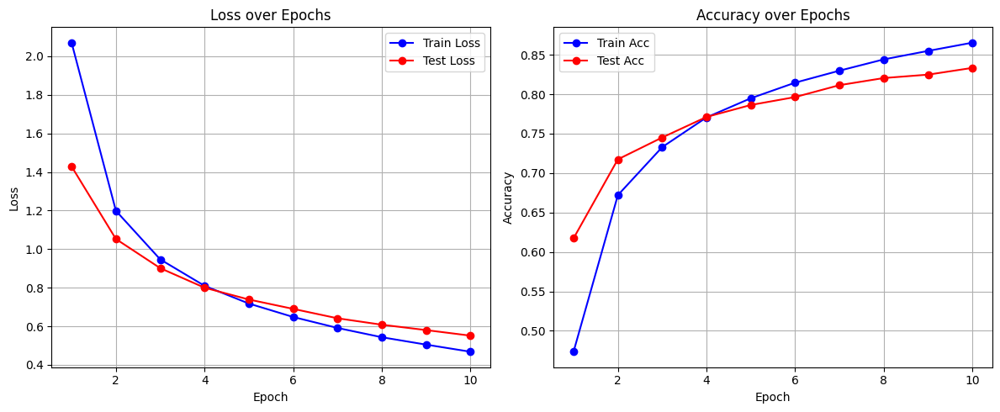

In [ ]:
plot_training_history(history)

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import torch

def mostrar_matriz_y_reporte(model, dataloader, device, class_names=None):
    """
    Evalúa el modelo, muestra matriz de confusión y clasificación.

    Args:
        model: Modelo PyTorch entrenado
        dataloader: DataLoader de evaluación
        device: 'cuda' o 'cpu'
        class_names: lista opcional de nombres de clase (por orden de índice)
    """
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for x_batch, y_batch in dataloader:
            x_batch = x_batch.to(device)
            y_batch = y_batch.to(device)

            outputs = model(x_batch)
            preds = torch.argmax(outputs, dim=1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(y_batch.cpu().numpy())

    # Matriz de confusión
    cm = confusion_matrix(all_labels, all_preds)
    plt.figure(figsize=(15, 15))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names if class_names else "auto",
                yticklabels=class_names if class_names else "auto")
    plt.xlabel('Predicción')
    plt.ylabel('Etiqueta real')
    plt.title('Matriz de Confusión')
    plt.tight_layout()
    plt.show()

    # Reporte de clasificación
    print("\nReporte de Clasificación:")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    return


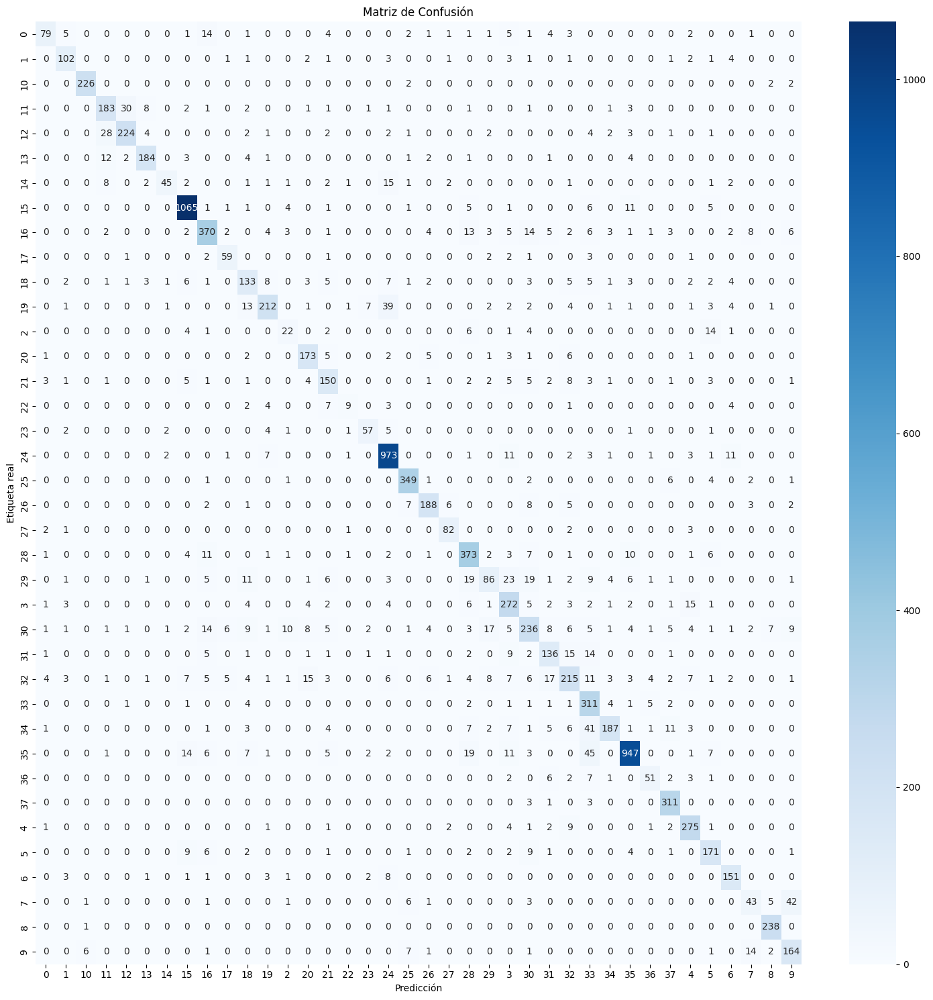


Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.83      0.63      0.71       126
           1       0.82      0.82      0.82       124
          10       0.97      0.97      0.97       232
          11       0.77      0.78      0.77       236
          12       0.86      0.81      0.83       277
          13       0.90      0.86      0.88       215
          14       0.87      0.53      0.66        85
          15       0.94      0.97      0.96      1102
          16       0.82      0.80      0.81       460
          17       0.79      0.82      0.80        72
          18       0.64      0.67      0.65       199
          19       0.85      0.72      0.78       296
           2       0.48      0.40      0.44        55
          20       0.81      0.86      0.84       200
          21       0.71      0.75      0.73       200
          22       0.60      0.30      0.40        30
          23       0.79      0.77      0.78        74


In [ ]:
class_names = train_dataset.classes  # si usás ImageFolder

# Mostrar todo
mostrar_matriz_y_reporte(model, test_loader, device, class_names)

In [ ]:
import matplotlib.pyplot as plt
import random
import torch

In [ ]:
import matplotlib.pyplot as plt
import random
import torch

def mostrar_predicciones_azar(model, dataloader, device, idx_to_label, cantidad=10):
    """
    Muestra predicciones aleatorias con imágenes del dataloader.

    Args:
        model: modelo entrenado
        dataloader: DataLoader de test o validación
        device: 'cuda' o 'cpu'
        idx_to_label: diccionario {índice: nombre de clase}
        cantidad: cantidad de imágenes a mostrar (por defecto 10)
    """
    model.eval()
    images, true_labels, pred_labels = [], [], []

    # Recolectar ejemplos suficientes
    with torch.no_grad():
        for x_batch, y_batch in dataloader:
            x_batch = x_batch.to(device)
            outputs = model(x_batch)
            preds = torch.argmax(outputs, dim=1)

            images.extend(x_batch.cpu())
            true_labels.extend(y_batch.cpu())
            pred_labels.extend(preds.cpu())

            if len(images) >= cantidad:
                break

    # Seleccionar aleatoriamente
    idxs = random.sample(range(len(images)), cantidad)
    selected_images = [images[i] for i in idxs]
    selected_true = [true_labels[i] for i in idxs]
    selected_pred = [pred_labels[i] for i in idxs]

    # Mostrar
    plt.figure(figsize=(15, 6))
    for i in range(cantidad):
        img = selected_images[i]
        true = selected_true[i].item()
        pred = selected_pred[i].item()

        # Desnormalizar si fue normalizado con mean=0.5 y std=0.5
        img = img * 0.5 + 0.5
        img = img.permute(1, 2, 0).numpy()

        plt.subplot(2, 5, i + 1)
        plt.imshow(img)
        plt.axis('off')
        title = f"Real: {idx_to_label[true]}\nPred: {idx_to_label[pred]}"
        color = "green" if true == pred else "red"
        plt.title(title, fontsize=10, color=color)

    plt.tight_layout()
    plt.show()


In [ ]:
dict(enumerate(le.classes_))

{0: 'Apple___Apple_scab',
 1: 'Apple___Black_rot',
 2: 'Apple___Cedar_apple_rust',
 3: 'Apple___healthy',
 4: 'Blueberry___healthy',
 5: 'Cherry_(including_sour)___Powdery_mildew',
 6: 'Cherry_(including_sour)___healthy',
 7: 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 8: 'Corn_(maize)___Common_rust_',
 9: 'Corn_(maize)___Northern_Leaf_Blight',
 10: 'Corn_(maize)___healthy',
 11: 'Grape___Black_rot',
 12: 'Grape___Esca_(Black_Measles)',
 13: 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 14: 'Grape___healthy',
 15: 'Orange___Haunglongbing_(Citrus_greening)',
 16: 'Peach___Bacterial_spot',
 17: 'Peach___healthy',
 18: 'Pepper,_bell___Bacterial_spot',
 19: 'Pepper,_bell___healthy',
 20: 'Potato___Early_blight',
 21: 'Potato___Late_blight',
 22: 'Potato___healthy',
 23: 'Raspberry___healthy',
 24: 'Soybean___healthy',
 25: 'Squash___Powdery_mildew',
 26: 'Strawberry___Leaf_scorch',
 27: 'Strawberry___healthy',
 28: 'Tomato___Bacterial_spot',
 29: 'Tomato___Early_blight',
 30: '

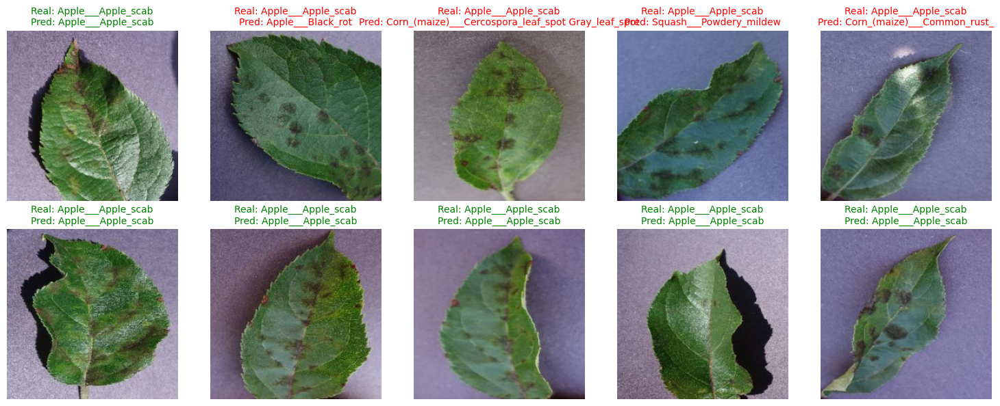

In [ ]:
# Si ya tenés el LabelEncoder:
idx_to_label = dict(enumerate(le.classes_))

# Usar la función
mostrar_predicciones_azar(model, test_loader, device, idx_to_label)

# VGG - Baseline Sin Compensacion de Clases

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import vgg16, VGG16
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.layers import RandomFlip, RandomRotation, RandomBrightness, RandomContrast
from tensorflow.keras.utils import image_dataset_from_directory
import matplotlib.pyplot as plt
from os.path import expanduser




In [ ]:
# Actualizá si usás más de 2 clases:
NUM_CLASSES = 38              # Usando multiclases
FINE_TUNE_AT = 4
LEARNING_RATE = 1e-5
EPOCHS = 30
BATCH_SIZE = 32
IMG_SIZE = (224, 224)
INPUT_SHAPE = (224, 224, 3)
MODEL_PATH = 'vgg_fine_tuned_best_multiclass.keras'

# Activar mixed precision si tenés GPU con tensor cores
tf.keras.mixed_precision.set_global_policy('mixed_float16')

In [ ]:
def build_vgg_model(num_classes, fine_tune_at, input_shape):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model.trainable = True

    # Congelar capas excepto las últimas `fine_tune_at`
    for layer in base_model.layers[:-fine_tune_at]:
        layer.trainable = False

    # Bloque superior personalizado
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(256, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001))(x)
    x = Dropout(0.5)(x)

    # 🔁 Activación y tamaño de salida según tipo de problema
    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=outputs)
    return model


In [ ]:
def prepare_dataset(dataset, augment=False):
    data_augmentation_pipeline = Sequential([
        RandomFlip('horizontal'),
        RandomRotation(factor=0.042),
        RandomBrightness(factor=0.1),
        RandomContrast(factor=0.1)
    ], name="data_augmentation")

    dataset = dataset.map(
        lambda x, y: (vgg16.preprocess_input(x), y),
        num_parallel_calls=tf.data.AUTOTUNE
    )
    if augment:
        dataset = dataset.map(
            lambda x, y: (data_augmentation_pipeline(x, training=True), y),
            num_parallel_calls=tf.data.AUTOTUNE
        )

    return dataset.prefetch(buffer_size=tf.data.AUTOTUNE)


In [ ]:
project_base_path = f"/content/"
TRAIN_DIR = f"{project_base_path}/splitted/train"
TEST_DIR = f"{project_base_path}/splitted/test"
print(f"Looking for training data in: {TRAIN_DIR}")
print(f"Looking for test data in: {TEST_DIR}")

train_dataset = image_dataset_from_directory(
    TRAIN_DIR,
    label_mode='categorical',         # 👈 CAMBIO CLAVE
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    shuffle=True
)

test_dataset = image_dataset_from_directory(
    TEST_DIR,
    label_mode='categorical',         # 👈 CAMBIO CLAVE
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    shuffle=False
)

class_names = train_dataset.class_names
print(f"Classes found: {class_names}")
idx_to_label = dict(enumerate(class_names))  # útil para visualización posterior

# Aplicar transformaciones
train_ds = prepare_dataset(train_dataset, augment=True)
test_ds = prepare_dataset(test_dataset)
print("Data pipelines created and optimized.")


Looking for training data in: /content//splitted/train
Looking for test data in: /content//splitted/test
Found 43444 files belonging to 38 classes.
Found 10861 files belonging to 38 classes.
Classes found: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Data pipelines created and optimized.


In [ ]:
class CustomLogger(tf.keras.callbacks.Callback):
    def __init__(self, epochs):
        super().__init__()
        self.epochs = epochs

    def on_epoch_end(self, epoch, logs=None):
        print(
            f"Epoch {epoch + 1}/{self.epochs} - "
            f"Train Loss: {logs.get('loss'):.4f} | "
            f"Val Loss: {logs.get('val_loss'):.4f} | "
            f"Train Acc: {logs.get('accuracy'):.4f} | "
            f"Val Acc: {logs.get('val_accuracy'):.4f}"
        )


In [ ]:
print("\n--- Step 2: Building the Model ---")
model = build_vgg_model(NUM_CLASSES, FINE_TUNE_AT, INPUT_SHAPE)

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE),
    loss='categorical_crossentropy',        # 👈 CAMBIO CLAVE
    metrics=['accuracy']
)

model.summary()


--- Step 2: Building the Model ---


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cast (Cast)                     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38)             │         9,766 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 14,855,782 (56.67 MB)

 Trainable params: 7,220,518 (27.54 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [ ]:
checkpoint = ModelCheckpoint(
    MODEL_PATH, monitor='val_accuracy', save_best_only=True, verbose=1)

early_stop = EarlyStopping(
    monitor='val_loss', patience=5, restore_best_weights=True)

custom_logger = CustomLogger(epochs=EPOCHS)

history_keras = model.fit(
    train_ds,
    epochs=EPOCHS,
    validation_data=test_ds,
    callbacks=[checkpoint, early_stop, custom_logger],
    verbose=0
)

history_compatible = {
    "train_loss": history_keras.history.get('loss', []),
    "test_loss": history_keras.history.get('val_loss', []),
    "train_acc": history_keras.history.get('accuracy', []),
    "test_acc": history_keras.history.get('val_accuracy', [])
}


Epoch 1: val_accuracy improved from -inf to 0.71909, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 1/30 - Train Loss: 2.4181 | Val Loss: 1.3833 | Train Acc: 0.4676 | Val Acc: 0.7191

Epoch 2: val_accuracy improved from 0.71909 to 0.80646, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 2/30 - Train Loss: 1.2112 | Val Loss: 1.0563 | Train Acc: 0.7476 | Val Acc: 0.8065

Epoch 3: val_accuracy improved from 0.80646 to 0.84090, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 3/30 - Train Loss: 0.9341 | Val Loss: 0.9173 | Train Acc: 0.8227 | Val Acc: 0.8409

Epoch 4: val_accuracy improved from 0.84090 to 0.85867, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 4/30 - Train Loss: 0.7929 | Val Loss: 0.8668 | Train Acc: 0.8585 | Val Acc: 0.8587

Epoch 5: val_accuracy improved from 0.85867 to 0.86226, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 5/30 - Train Loss: 0.7062 | Val Loss: 0.8348 | Train Acc: 0.8822 | Val Acc: 0.8623

Epoch 6

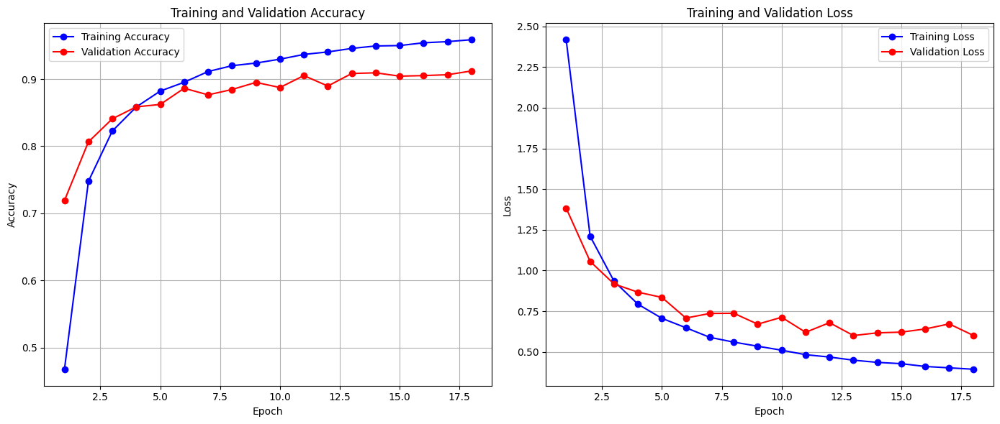

In [ ]:
def plot_training_history(history):
    train_acc = history['train_acc']
    test_acc = history['test_acc']
    train_loss = history['train_loss']
    test_loss = history['test_loss']
    epochs_range = range(1, len(train_acc) + 1)

    plt.figure(figsize=(14, 6))

    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, train_acc, 'bo-', label='Training Accuracy')
    plt.plot(epochs_range, test_acc, 'ro-', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, train_loss, 'bo-', label='Training Loss')
    plt.plot(epochs_range, test_loss, 'ro-', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

# Ejecutar
plot_training_history(history_compatible)


In [ ]:
from matplotlib.ticker import MultipleLocator, AutoMinorLocator

def plot_training_history(history):
    train_acc = history['train_acc']
    test_acc = history['test_acc']
    train_loss = history['train_loss']
    test_loss = history['test_loss']
    epochs_range = range(1, len(train_acc) + 1)

    plt.figure(figsize=(14, 6))

    # Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, train_acc, 'bo-', label='Training Accuracy')
    plt.plot(epochs_range, test_acc, 'ro-', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.gca().xaxis.set_major_locator(MultipleLocator(1))
    plt.gca().xaxis.set_minor_locator(AutoMinorLocator(2))
    plt.gca().yaxis.set_minor_locator(AutoMinorLocator(2))

    # Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, train_loss, 'bo-', label='Training Loss')
    plt.plot(epochs_range, test_loss, 'ro-', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.gca().xaxis.set_major_locator(MultipleLocator(1))
    plt.gca().xaxis.set_minor_locator(AutoMinorLocator(2))
    plt.gca().yaxis.set_minor_locator(AutoMinorLocator(2))

    plt.tight_layout()
    plt.show()

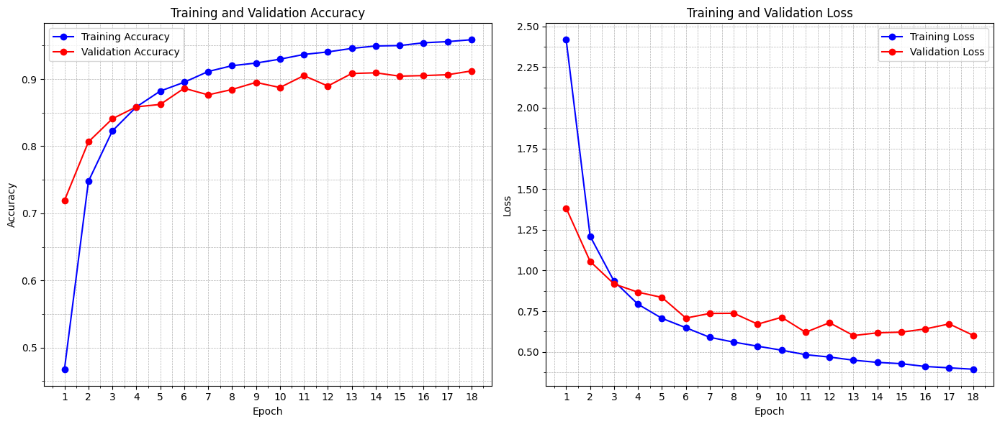

In [ ]:
# Ejecutar
plot_training_history(history_compatible)

In [ ]:
print("\n--- Step 6: Final Evaluation with the Best Model ---")
best_model = tf.keras.models.load_model(MODEL_PATH)
loss, accuracy = best_model.evaluate(test_ds)
print(f"Final accuracy of the best model: {accuracy:.2%}")


--- Step 6: Final Evaluation with the Best Model ---
340/340 ━━━━━━━━━━━━━━━━━━━━ 17s 46ms/step - accuracy: 0.9329 - loss: 0.5238
Final accuracy of the best model: 91.22%


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from sklearn.metrics import confusion_matrix, classification_report
import tensorflow as tf

In [ ]:
def mostrar_matriz_y_reporte_vgg(model, test_dir, class_names, img_size=(224, 224), batch_size=16):
    """
    Evalúa un modelo Keras cargado con imágenes desde carpetas.
    Muestra matriz de confusión y reporte de clasificación.

    Args:
        model: modelo Keras entrenado
        test_dir: carpeta raíz con subcarpetas por clase
        class_names: lista de nombres de clases
        img_size: tupla con tamaño de imagen (default 224x224)
        batch_size: tamaño del batch (default 16)
    """
    y_true = []
    y_pred = []
    all_paths = []
    all_labels = []

    # Crear mapeo de clase a índice
    class_to_idx = {name: idx for idx, name in enumerate(class_names)}

    print(f"Buscando imágenes en: {test_dir}")
    print(f"Clases esperadas: {class_names}")

    # Verificar que el directorio existe
    if not os.path.exists(test_dir):
        raise FileNotFoundError(f"El directorio {test_dir} no existe")

    # Recopilar todas las rutas de imágenes
    for class_name in class_names:
        class_path = os.path.join(test_dir, class_name)

        if not os.path.exists(class_path):
            print(f"[WARNING] No se encontró la carpeta: {class_path}")
            continue

        # Buscar archivos de imagen válidos
        valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')
        image_files = [f for f in os.listdir(class_path)
                      if f.lower().endswith(valid_extensions)]

        print(f"Clase '{class_name}': {len(image_files)} imágenes encontradas")

        for fname in image_files:
            fpath = os.path.join(class_path, fname)
            all_paths.append(fpath)
            all_labels.append(class_to_idx[class_name])

    if not all_paths:
        raise ValueError("No se encontraron imágenes válidas en el directorio de prueba")

    print(f"Total de imágenes para evaluar: {len(all_paths)}")

    # Procesar imágenes en lotes
    for i in tqdm(range(0, len(all_paths), batch_size), desc="Procesando imágenes"):
        batch_paths = all_paths[i:i+batch_size]
        batch_labels = all_labels[i:i+batch_size]

        batch_imgs = []
        valid_labels = []

        for path, label in zip(batch_paths, batch_labels):
            try:
                # Cargar y preprocesar imagen
                img = tf.keras.utils.load_img(path, target_size=img_size)
                img_array = tf.keras.utils.img_to_array(img)
                img_array = tf.keras.applications.vgg16.preprocess_input(img_array)

                batch_imgs.append(img_array)
                valid_labels.append(label)

            except Exception as e:
                print(f"[ERROR] No se pudo procesar: {path} | Error: {e}")
                continue

        if not batch_imgs:
            continue

        # Hacer predicciones
        batch_imgs = np.array(batch_imgs)
        try:
            preds = model.predict(batch_imgs, verbose=0)
            batch_pred = np.argmax(preds, axis=1)

            y_true.extend(valid_labels)
            y_pred.extend(batch_pred)

        except Exception as e:
            print(f"[ERROR] Error en predicción del lote: {e}")
            continue

    if not y_true or not y_pred:
        raise ValueError("No se pudieron procesar predicciones válidas")

    # Convertir a arrays numpy
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    print(f"Predicciones completadas: {len(y_true)} imágenes procesadas")

    # Crear y mostrar matriz de confusión
    cm = confusion_matrix(y_true, y_pred)

    plt.figure(figsize=(max(8, len(class_names)), max(6, len(class_names))))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names,
                cbar_kws={'label': 'Número de muestras'})

    plt.xlabel("Predicción", fontsize=12)
    plt.ylabel("Etiqueta Real", fontsize=12)
    plt.title("Matriz de Confusión - Modelo VGG16", fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

    # Mostrar estadísticas básicas
    accuracy = np.sum(y_true == y_pred) / len(y_true)
    print(f"\nAccuracy total: {accuracy:.4f} ({accuracy*100:.2f}%)")

    # Reporte de clasificación detallado
    print("\n" + "="*50)
    print("REPORTE DE CLASIFICACIÓN DETALLADO")
    print("="*50)

    report = classification_report(
        y_true, y_pred,
        target_names=class_names,
        digits=4,
        zero_division=0
    )
    print(report)

    # Estadísticas por clase
    print("\n" + "="*50)
    print("ESTADÍSTICAS POR CLASE")
    print("="*50)

    for i, class_name in enumerate(class_names):
        class_mask = (y_true == i)
        if np.sum(class_mask) > 0:
            class_accuracy = np.sum((y_true == i) & (y_pred == i)) / np.sum(class_mask)
            total_samples = np.sum(class_mask)
            correct_preds = np.sum((y_true == i) & (y_pred == i))

            print(f"{class_name:15} | Samples: {total_samples:3d} | "
                  f"Correct: {correct_preds:3d} | Accuracy: {class_accuracy:.4f}")

    return y_true, y_pred, cm

In [ ]:
# Función de uso rápido
def evaluar_modelo_completo(model_path, test_dir, class_names):
    """
    Función completa para evaluar un modelo guardado
    """
    try:
        # Cargar el modelo
        print("Cargando modelo...")
        model = tf.keras.models.load_model(model_path)
        print("Modelo cargado exitosamente")

        # Evaluar
        y_true, y_pred, cm = mostrar_matriz_y_reporte_vgg(
            model, test_dir, class_names
        )

        return model, y_true, y_pred, cm

    except Exception as e:
        print(f"Error al evaluar el modelo: {e}")
        return None, None, None, None

Cargando modelo...
Modelo cargado exitosamente
Buscando imágenes en: /content/splitted/test
Clases esperadas: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Clase '0': 126 imágenes encontradas
Clase '1': 124 imágenes encontradas
Clase '10': 232 imágenes encontradas
Clase '11': 236 imágenes encontradas
Clase '12': 277 imágenes encontradas
Clase '13': 215 imágenes encontradas
Clase '14': 85 imágenes encontradas
Clase '15': 1102 imágenes encontradas
Clase '16': 460 imágenes encontradas
Clase '17': 72 imágenes encontradas
Clase '18': 199 imágenes encontradas
Clase '19': 296 imágenes encontradas
Clase '2': 55 imágenes encontradas
Clase '20': 200 imágenes encontradas
Clase '21': 200 imágenes encontradas
Clase '22': 30 imágenes encontradas
Clase '23': 74 imágenes encontradas
Clase '24': 1018 imágenes encontradas
Clase '25':

Procesando imágenes: 100%|██████████| 679/679 [01:36<00:00,  7.03it/s]


Predicciones completadas: 10861 imágenes procesadas


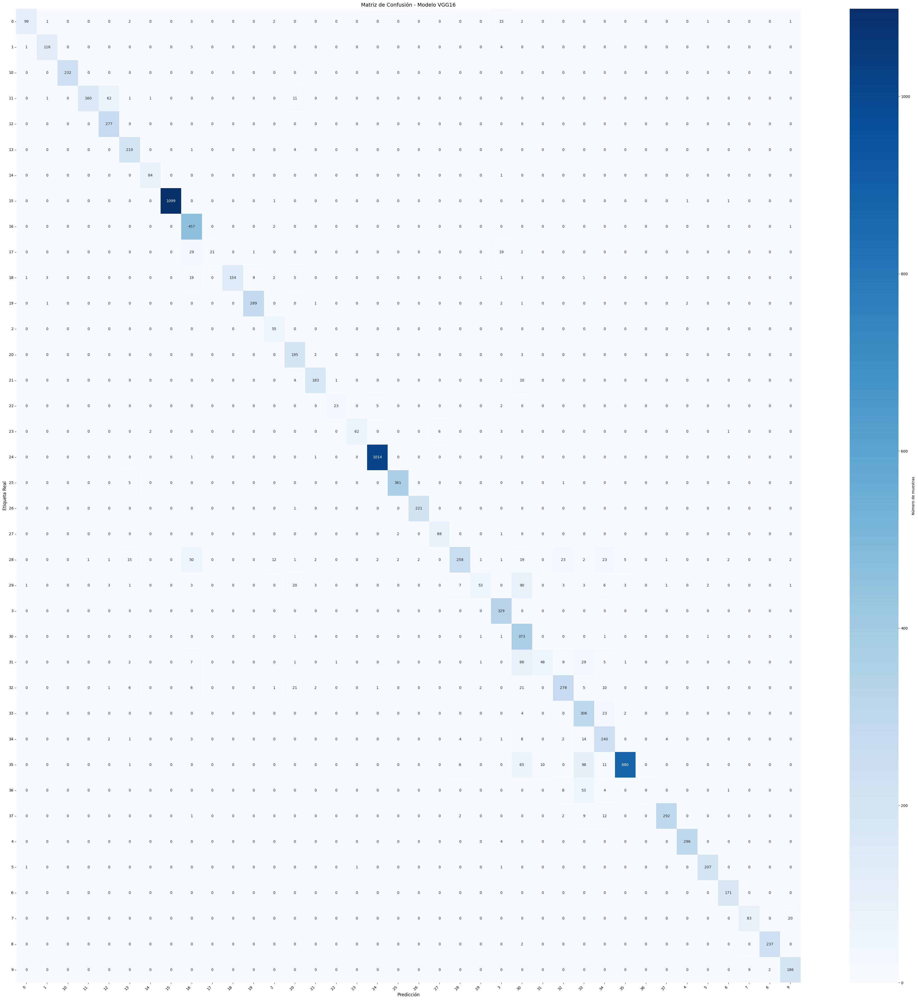


Accuracy total: 0.8881 (88.81%)

REPORTE DE CLASIFICACIÓN DETALLADO
              precision    recall  f1-score   support

           0     0.9612    0.7857    0.8646       126
           1     0.9508    0.9355    0.9431       124
          10     1.0000    1.0000    1.0000       232
          11     0.9938    0.6780    0.8060       236
          12     0.8006    1.0000    0.8892       277
          13     0.8607    0.9767    0.9150       215
          14     0.9655    0.9882    0.9767        85
          15     1.0000    0.9973    0.9986      1102
          16     0.7839    0.9935    0.8763       460
          17     1.0000    0.2917    0.4516        72
          18     1.0000    0.7739    0.8725       199
          19     0.9666    0.9764    0.9714       296
           2     0.7333    1.0000    0.8462        55
          20     0.7386    0.9750    0.8405       200
          21     0.9242    0.9150    0.9196       200
          22     0.9200    0.7667    0.8364        30
          23

In [ ]:
# # Opción 1: Si ya tienes el modelo cargado
#mostrar_matriz_y_reporte_vgg(best_model, TEST_DIR, class_names)
#
# # Opción 2: Evaluar desde archivo guardado
model, y_true, y_pred, cm = evaluar_modelo_completo(
     '/content/vgg_fine_tuned_best_multiclass.keras', '/content/splitted/test', class_names)

# VGG Con Compensacion de Clases

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import image_dataset_from_directory
import matplotlib.pyplot as plt
from collections import Counter
import shutil
from pathlib import Path
import cv2
from tqdm import tqdm

## Analisis del desbalance

In [ ]:
def analizar_desbalance_dataset(dataset_path, show_plot=True):
    """
    Analiza el desbalance de clases en el dataset
    """
    print("🔍 ANÁLISIS DEL DESBALANCE DEL DATASET")
    print("="*50)

    class_counts = {}
    total_images = 0

    # Contar imágenes por clase
    for class_name in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_name)
        if os.path.isdir(class_path):
            count = len([f for f in os.listdir(class_path)
                        if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))])
            class_counts[class_name] = count
            total_images += count
            print(f"{class_name:20}: {count:5d} imágenes")

    print(f"\nTotal de imágenes: {total_images}")

    # Calcular estadísticas
    counts = list(class_counts.values())
    max_count = max(counts)
    min_count = min(counts)
    mean_count = np.mean(counts)
    std_count = np.std(counts)

    print(f"\nEstadísticas:")
    print(f"  Clase mayor: {max_count} imágenes")
    print(f"  Clase menor: {min_count} imágenes")
    print(f"  Promedio: {mean_count:.1f} imágenes")
    print(f"  Desv. estándar: {std_count:.1f}")
    print(f"  Ratio desbalance: {max_count/min_count:.2f}:1")

    # Identificar clases minoritarias (menos del 70% del promedio)
    threshold = mean_count * 0.7 # UMBRAL!!
    minority_classes = {k: v for k, v in class_counts.items() if v < threshold}

    print(f"\nClases minoritarias (< {threshold:.0f} imágenes):")
    for class_name, count in minority_classes.items():
        print(f"  {class_name}: {count} imágenes (faltan {max_count - count})")

    # Visualizar
    if show_plot:
        plt.figure(figsize=(12, 6))
        classes = list(class_counts.keys())
        counts = list(class_counts.values())

        colors = ['red' if count < threshold else 'skyblue' for count in counts]

        plt.bar(classes, counts, color=colors, alpha=0.7)
        plt.axhline(y=threshold, color='orange', linestyle='--',
                   label=f'Umbral minoritarias ({threshold:.0f})')
        plt.axhline(y=mean_count, color='green', linestyle='--',
                   label=f'Promedio ({mean_count:.0f})')

        plt.title('Distribución de Clases en el Dataset')
        plt.xlabel('Clases')
        plt.ylabel('Número de Imágenes')
        plt.xticks(rotation=45, ha='right')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()

    return class_counts, minority_classes, max_count

## Configuracion de augmentacion estrategica

In [ ]:
def crear_augmentador_avanzado(augmentation_strength='medium'):
    """
    Crea un generador de data augmentation con diferentes niveles de intensidad
    """

    if augmentation_strength == 'light':
        return ImageDataGenerator(
            rotation_range=15,
            width_shift_range=0.1,
            height_shift_range=0.1,
            shear_range=0.1,
            zoom_range=0.1,
            horizontal_flip=True,
            brightness_range=[0.9, 1.1],
            fill_mode='nearest'
        )

    elif augmentation_strength == 'medium':
        return ImageDataGenerator(
            rotation_range=25,
            width_shift_range=0.15,
            height_shift_range=0.15,
            shear_range=0.15,
            zoom_range=0.15,
            horizontal_flip=True,
            vertical_flip=False,
            brightness_range=[0.8, 1.2],
            channel_shift_range=0.1,
            fill_mode='nearest'
        )

    elif augmentation_strength == 'strong':
        return ImageDataGenerator(
            rotation_range=35,
            width_shift_range=0.20,
            height_shift_range=0.20,
            shear_range=0.20,
            zoom_range=0.20,
            horizontal_flip=True,
            vertical_flip=True,
            brightness_range=[0.7, 1.3],
            channel_shift_range=0.15,
            fill_mode='nearest'
        )


## Generacion selectiva de imagenes

In [ ]:
def generar_imagenes_minoritarias(source_dir, output_dir, class_counts, target_count,
                                augmentation_strength='medium', img_size=(224, 224)):
    """
    Genera imágenes sintéticas solo para las clases minoritarias
    """
    print("\n GENERANDO IMÁGENES PARA CLASES MINORITARIAS")
    print("="*60)

    # Crear directorio de salida
    os.makedirs(output_dir, exist_ok=True)

    datagen = crear_augmentador_avanzado(augmentation_strength)

    total_generated = 0

    for class_name, original_count in class_counts.items():
        class_source_dir = os.path.join(source_dir, class_name)
        class_output_dir = os.path.join(output_dir, class_name)

        # Crear directorio de clase
        os.makedirs(class_output_dir, exist_ok=True)

        # Copiar imágenes originales primero
        print(f"\n Procesando clase: {class_name}")
        original_files = [f for f in os.listdir(class_source_dir)
                         if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]

        # Copiar originales
        for file in original_files:
            shutil.copy2(os.path.join(class_source_dir, file),
                        os.path.join(class_output_dir, file))

        # Calcular cuántas imágenes generar
        images_needed = max(0, target_count - original_count)

        if images_needed == 0:
            print(f"  Clase ya balanceada ({original_count} >= {target_count})")
            continue

        print(f"  Originales: {original_count}")
        print(f"  Objetivo: {target_count}")
        print(f"  A generar: {images_needed}")

        # Generar imágenes sintéticas
        generated_count = 0

        # Cargar todas las imágenes de la clase
        class_images = []
        for file in original_files:
            img_path = os.path.join(class_source_dir, file)
            try:
                img = load_img(img_path, target_size=img_size)
                img_array = img_to_array(img)
                class_images.append(img_array)
            except Exception as e:
                print(f"    Error cargando {file}: {e}")

        if not class_images:
            print(f"    No se pudieron cargar imágenes para {class_name}")
            continue

        class_images = np.array(class_images)

        # Configurar generador
        gen = datagen.flow(
            class_images,
            batch_size=1,
            save_to_dir=class_output_dir,
            save_prefix=f'aug_{class_name}',
            save_format='jpg'
        )

        # Generar imágenes con barra de progreso
        pbar = tqdm(range(images_needed), desc=f"  Generando {class_name}")

        for i in pbar:
            try:
                batch = next(gen)
                generated_count += 1
                total_generated += 1

                # Actualizar descripción de la barra
                pbar.set_description(f"  Generando {class_name} ({generated_count}/{images_needed})")

            except Exception as e:
                print(f"    Error generando imagen {i}: {e}")
                break

        print(f"  Generadas: {generated_count} imágenes")

    print(f"\n RESUMEN:")
    print(f"Total de imágenes generadas: {total_generated}")
    print(f"Dataset balanceado guardado en: {output_dir}")

    return total_generated

## Balanceo artificial de clases

In [ ]:
def balancear_dataset_inteligente(source_dir, output_dir, strategy='auto', target_images=None):
    """
    Balancea el dataset usando múltiples estrategias

    Estrategias:
    - 'auto': Automática basada en estadísticas
    - 'max': Igualar todas las clases a la clase mayoritaria
    - 'mean': Igualar todas las clases al promedio
    - 'custom': Usar target_images específico
    """

    print("🚀 INICIANDO BALANCEADO INTELLIGENT DEL DATASET")
    print("="*60)

    # Paso 1: Analizar desbalance
    class_counts, minority_classes, max_count = analizar_desbalance_dataset(source_dir)

    # Paso 2: Determinar objetivo según estrategia
    if strategy == 'max':
        target_count = max_count
        print(f"\n Estrategia: Igualar a clase mayoritaria ({target_count} imágenes)")

    elif strategy == 'mean':
        target_count = int(np.mean(list(class_counts.values())))
        print(f"\n Estrategia: Igualar al promedio ({target_count} imágenes)")

    elif strategy == 'custom' and target_images:
        target_count = target_images
        print(f"\n Estrategia: Objetivo personalizado ({target_count} imágenes)")

    else:  # 'auto'
        # Estrategia automática: usar percentil 75
        target_count = int(np.percentile(list(class_counts.values()), 75)) # umbral P75
        print(f"\n Estrategia: Automática - Percentil 75 ({target_count} imágenes)")

    # Paso 3: Calcular work load
    total_to_generate = sum(max(0, target_count - count) for count in class_counts.values())
    print(f"Total de imágenes a generar: {total_to_generate}")

    if total_to_generate == 0:
        print(" El dataset ya está balanceado!")
        return class_counts

    # Paso 4: Determinar intensidad de augmentation
    max_multiplier = max(target_count / count for count in class_counts.values())

    if max_multiplier <= 2:
        aug_strength = 'light'
    elif max_multiplier <= 4:
        aug_strength = 'medium'
    else:
        aug_strength = 'strong'

    print(f"Multiplicador máximo: {max_multiplier:.1f}x")
    print(f"Intensidad de augmentation: {aug_strength}")

    # Paso 5: Generar imágenes
    total_generated = generar_imagenes_minoritarias(
        source_dir, output_dir, class_counts, target_count, aug_strength
    )

    # Paso 6: Verificar resultado
    print(f"\n PROCESO COMPLETADO")
    print(f"Dataset balanceado creado en: {output_dir}")

    # Analizar resultado final
    final_counts, _, _ = analizar_desbalance_dataset(output_dir, show_plot=False)

    return final_counts

## Validacion y Visualizacion

In [ ]:
def visualizar_augmentation_samples(source_dir, class_name, n_samples=5, augmentation_strength='medium'):
    """
    Muestra ejemplos de las transformaciones aplicadas
    """
    class_dir = os.path.join(source_dir, class_name)
    files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

    if not files:
        print(f"No se encontraron imágenes en {class_dir}")
        return

    # Tomar una imagen de muestra
    sample_file = files[0]
    img_path = os.path.join(class_dir, sample_file)
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)

    # Crear generador
    datagen = crear_augmentador_avanzado(augmentation_strength)
    gen = datagen.flow(img_array, batch_size=1)

    # Visualizar
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))

    # Imagen original
    axes[0, 0].imshow(img)
    axes[0, 0].set_title('Original')
    axes[0, 0].axis('off')

    # Imágenes aumentadas
    for i in range(n_samples):
        row = i // 3
        col = (i + 1) % 3

        augmented = next(gen)[0].astype('uint8')
        axes[row, col].imshow(augmented)
        axes[row, col].set_title(f'Augmented {i+1}')
        axes[row, col].axis('off')

    plt.suptitle(f'Ejemplos de Data Augmentation - Clase: {class_name}')
    plt.tight_layout()
    plt.show()

## Ejecucion de la estrategia de compensacion

In [ ]:
def ejecutar_estrategia_completa(train_dir, output_dir, strategy='auto', target_images=None,
                               visualizar_ejemplos=True):
    """
    Ejecuta la estrategia completa de balanceado de dataset
    """

    print("🎯 ESTRATEGIA COMPLETA DE BALANCEADO DE DATASET")
    print("="*60)
    print(f"Directorio origen: {train_dir}")
    print(f"Directorio salida: {output_dir}")
    print(f"Estrategia: {strategy}")

    # Verificar que el directorio existe
    if not os.path.exists(train_dir):
        print(f" Error: No existe el directorio {train_dir}")
        return None

    # Ejecutar balanceado
    try:
        final_counts = balancear_dataset_inteligente(
            train_dir, output_dir, strategy, target_images
        )

        # Mostrar ejemplos de augmentation si se solicita
        if visualizar_ejemplos:
            print("\n  EJEMPLOS DE DATA AUGMENTATION")
            print("="*40)

            # Tomar las primeras 2 clases para mostrar ejemplos
            sample_classes = list(final_counts.keys())[:2]

            for class_name in sample_classes:
                print(f"\nEjemplos para clase: {class_name}")
                visualizar_augmentation_samples(train_dir, class_name)

        print("\n ESTRATEGIA COMPLETADA EXITOSAMENTE")
        return final_counts

    except Exception as e:
        print(f" Error durante el proceso: {e}")
        return None



In [ ]:
# 1. Definir rutas
TRAIN_DIR = "/content/splitted/train"  # Tu directorio actual
BALANCED_DIR = "/content/balanced_dataset/train"  # Nuevo directorio balanceado

🔍 ANÁLISIS DEL DESBALANCE DEL DATASET
29                  :   800 imágenes
19                  :  1182 imágenes
37                  :  1273 imágenes
6                   :   683 imágenes
34                  :  1123 imágenes
32                  :  1417 imágenes
26                  :   887 imágenes
16                  :  1837 imágenes
12                  :  1106 imágenes
20                  :   800 imágenes
21                  :   800 imágenes
27                  :   365 imágenes
8                   :   953 imágenes
15                  :  4405 imágenes
9                   :   788 imágenes
1                   :   497 imágenes
28                  :  1702 imágenes
36                  :   298 imágenes
22                  :   122 imágenes
33                  :  1341 imágenes
23                  :   297 imágenes
2                   :   220 imágenes
18                  :   798 imágenes
5                   :   842 imágenes
7                   :   410 imágenes
17                  :   288 imágenes


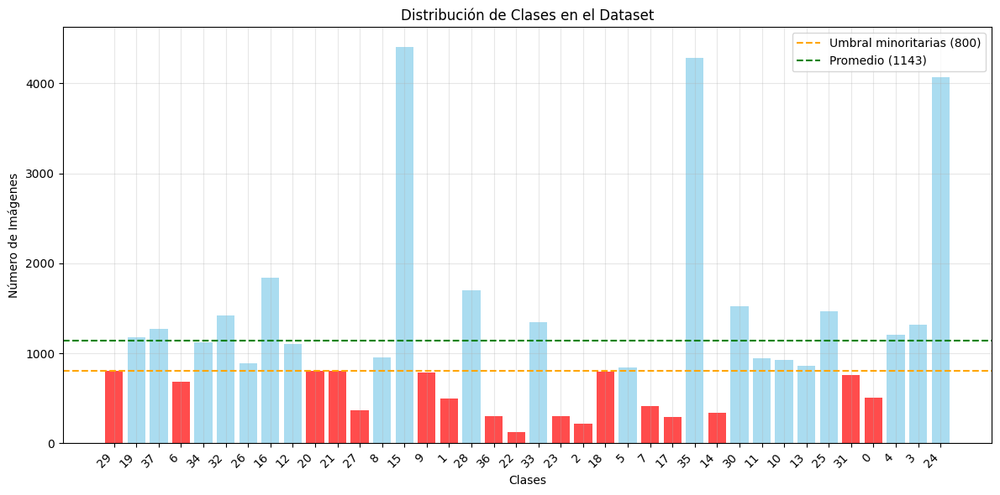

In [ ]:
# 2. Analizar el desbalance actual
class_counts, minority_classes, max_count = analizar_desbalance_dataset(TRAIN_DIR)

🎯 ESTRATEGIA COMPLETA DE BALANCEADO DE DATASET
📂 Directorio origen: /content/splitted/train
📂 Directorio salida: /content/balanced_dataset/train
📊 Estrategia: auto
🚀 INICIANDO BALANCEADO INTELLIGENT DEL DATASET
🔍 ANÁLISIS DEL DESBALANCE DEL DATASET
29                  :   800 imágenes
19                  :  1182 imágenes
37                  :  1273 imágenes
6                   :   683 imágenes
34                  :  1123 imágenes
32                  :  1417 imágenes
26                  :   887 imágenes
16                  :  1837 imágenes
12                  :  1106 imágenes
20                  :   800 imágenes
21                  :   800 imágenes
27                  :   365 imágenes
8                   :   953 imágenes
15                  :  4405 imágenes
9                   :   788 imágenes
1                   :   497 imágenes
28                  :  1702 imágenes
36                  :   298 imágenes
22                  :   122 imágenes
33                  :  1341 imágenes
23         

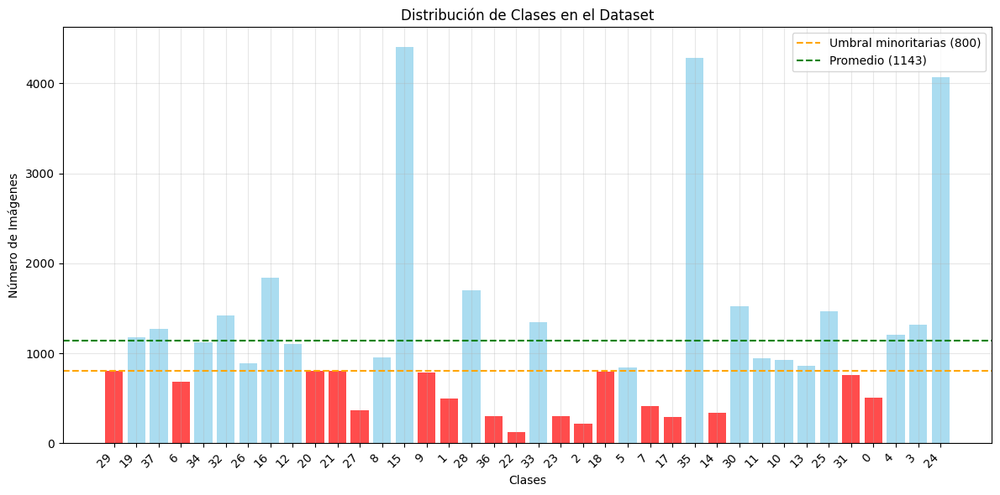


📊 Estrategia: Automática - Percentil 75 (1305 imágenes)
Total de imágenes a generar: 16467
Multiplicador máximo: 10.7x
Intensidad de augmentation: strong

🔄 GENERANDO IMÁGENES PARA CLASES MINORITARIAS

📁 Procesando clase: 29
  📊 Originales: 800
  🎯 Objetivo: 1305
  ➕ A generar: 505


  Generando 29 (505/505): 100%|██████████| 505/505 [00:06<00:00, 72.90it/s]


  ✅ Generadas: 505 imágenes

📁 Procesando clase: 19
  📊 Originales: 1182
  🎯 Objetivo: 1305
  ➕ A generar: 123


  Generando 19 (123/123): 100%|██████████| 123/123 [00:01<00:00, 73.68it/s]


  ✅ Generadas: 123 imágenes

📁 Procesando clase: 37
  📊 Originales: 1273
  🎯 Objetivo: 1305
  ➕ A generar: 32


  Generando 37 (32/32): 100%|██████████| 32/32 [00:00<00:00, 73.14it/s]


  ✅ Generadas: 32 imágenes

📁 Procesando clase: 6
  📊 Originales: 683
  🎯 Objetivo: 1305
  ➕ A generar: 622


  Generando 6 (622/622): 100%|██████████| 622/622 [00:09<00:00, 68.38it/s]


  ✅ Generadas: 622 imágenes

📁 Procesando clase: 34
  📊 Originales: 1123
  🎯 Objetivo: 1305
  ➕ A generar: 182


  Generando 34 (182/182): 100%|██████████| 182/182 [00:02<00:00, 63.72it/s]


  ✅ Generadas: 182 imágenes

📁 Procesando clase: 32
  ✅ Clase ya balanceada (1417 >= 1305)

📁 Procesando clase: 26
  📊 Originales: 887
  🎯 Objetivo: 1305
  ➕ A generar: 418


  Generando 26 (418/418): 100%|██████████| 418/418 [00:05<00:00, 72.38it/s]


  ✅ Generadas: 418 imágenes

📁 Procesando clase: 16
  ✅ Clase ya balanceada (1837 >= 1305)

📁 Procesando clase: 12
  📊 Originales: 1106
  🎯 Objetivo: 1305
  ➕ A generar: 199


  Generando 12 (199/199): 100%|██████████| 199/199 [00:02<00:00, 70.34it/s]


  ✅ Generadas: 199 imágenes

📁 Procesando clase: 20
  📊 Originales: 800
  🎯 Objetivo: 1305
  ➕ A generar: 505


  Generando 20 (505/505): 100%|██████████| 505/505 [00:06<00:00, 73.28it/s]


  ✅ Generadas: 505 imágenes

📁 Procesando clase: 21
  📊 Originales: 800
  🎯 Objetivo: 1305
  ➕ A generar: 505


  Generando 21 (505/505): 100%|██████████| 505/505 [00:07<00:00, 69.20it/s]


  ✅ Generadas: 505 imágenes

📁 Procesando clase: 27
  📊 Originales: 365
  🎯 Objetivo: 1305
  ➕ A generar: 940


  Generando 27 (940/940): 100%|██████████| 940/940 [00:13<00:00, 71.46it/s]


  ✅ Generadas: 940 imágenes

📁 Procesando clase: 8
  📊 Originales: 953
  🎯 Objetivo: 1305
  ➕ A generar: 352


  Generando 8 (352/352): 100%|██████████| 352/352 [00:04<00:00, 71.05it/s]


  ✅ Generadas: 352 imágenes

📁 Procesando clase: 15
  ✅ Clase ya balanceada (4405 >= 1305)

📁 Procesando clase: 9
  📊 Originales: 788
  🎯 Objetivo: 1305
  ➕ A generar: 517


  Generando 9 (517/517): 100%|██████████| 517/517 [00:07<00:00, 72.59it/s]


  ✅ Generadas: 517 imágenes

📁 Procesando clase: 1
  📊 Originales: 497
  🎯 Objetivo: 1305
  ➕ A generar: 808


  Generando 1 (808/808): 100%|██████████| 808/808 [00:11<00:00, 71.27it/s]


  ✅ Generadas: 808 imágenes

📁 Procesando clase: 28
  ✅ Clase ya balanceada (1702 >= 1305)

📁 Procesando clase: 36
  📊 Originales: 298
  🎯 Objetivo: 1305
  ➕ A generar: 1007


  Generando 36 (1007/1007): 100%|██████████| 1007/1007 [00:14<00:00, 70.74it/s]


  ✅ Generadas: 1007 imágenes

📁 Procesando clase: 22
  📊 Originales: 122
  🎯 Objetivo: 1305
  ➕ A generar: 1183


  Generando 22 (1183/1183): 100%|██████████| 1183/1183 [00:16<00:00, 71.71it/s]


  ✅ Generadas: 1183 imágenes

📁 Procesando clase: 33
  ✅ Clase ya balanceada (1341 >= 1305)

📁 Procesando clase: 23
  📊 Originales: 297
  🎯 Objetivo: 1305
  ➕ A generar: 1008


  Generando 23 (1008/1008): 100%|██████████| 1008/1008 [00:14<00:00, 71.46it/s]


  ✅ Generadas: 1008 imágenes

📁 Procesando clase: 2
  📊 Originales: 220
  🎯 Objetivo: 1305
  ➕ A generar: 1085


  Generando 2 (1085/1085): 100%|██████████| 1085/1085 [00:15<00:00, 71.32it/s]


  ✅ Generadas: 1085 imágenes

📁 Procesando clase: 18
  📊 Originales: 798
  🎯 Objetivo: 1305
  ➕ A generar: 507


  Generando 18 (507/507): 100%|██████████| 507/507 [00:07<00:00, 70.97it/s]


  ✅ Generadas: 507 imágenes

📁 Procesando clase: 5
  📊 Originales: 842
  🎯 Objetivo: 1305
  ➕ A generar: 463


  Generando 5 (463/463): 100%|██████████| 463/463 [00:06<00:00, 71.20it/s]


  ✅ Generadas: 463 imágenes

📁 Procesando clase: 7
  📊 Originales: 410
  🎯 Objetivo: 1305
  ➕ A generar: 895


  Generando 7 (895/895): 100%|██████████| 895/895 [00:12<00:00, 71.78it/s]


  ✅ Generadas: 895 imágenes

📁 Procesando clase: 17
  📊 Originales: 288
  🎯 Objetivo: 1305
  ➕ A generar: 1017


  Generando 17 (1017/1017): 100%|██████████| 1017/1017 [00:14<00:00, 71.95it/s]


  ✅ Generadas: 1017 imágenes

📁 Procesando clase: 35
  ✅ Clase ya balanceada (4286 >= 1305)

📁 Procesando clase: 14
  📊 Originales: 338
  🎯 Objetivo: 1305
  ➕ A generar: 967


  Generando 14 (967/967): 100%|██████████| 967/967 [00:13<00:00, 72.45it/s]


  ✅ Generadas: 967 imágenes

📁 Procesando clase: 30
  ✅ Clase ya balanceada (1527 >= 1305)

📁 Procesando clase: 11
  📊 Originales: 944
  🎯 Objetivo: 1305
  ➕ A generar: 361


  Generando 11 (361/361): 100%|██████████| 361/361 [00:04<00:00, 72.29it/s]


  ✅ Generadas: 361 imágenes

📁 Procesando clase: 10
  📊 Originales: 930
  🎯 Objetivo: 1305
  ➕ A generar: 375


  Generando 10 (375/375): 100%|██████████| 375/375 [00:05<00:00, 72.36it/s]


  ✅ Generadas: 375 imágenes

📁 Procesando clase: 13
  📊 Originales: 861
  🎯 Objetivo: 1305
  ➕ A generar: 444


  Generando 13 (444/444): 100%|██████████| 444/444 [00:06<00:00, 72.36it/s]


  ✅ Generadas: 444 imágenes

📁 Procesando clase: 25
  ✅ Clase ya balanceada (1468 >= 1305)

📁 Procesando clase: 31
  📊 Originales: 762
  🎯 Objetivo: 1305
  ➕ A generar: 543


  Generando 31 (543/543): 100%|██████████| 543/543 [00:07<00:00, 73.40it/s]


  ✅ Generadas: 543 imágenes

📁 Procesando clase: 0
  📊 Originales: 504
  🎯 Objetivo: 1305
  ➕ A generar: 801


  Generando 0 (801/801): 100%|██████████| 801/801 [00:11<00:00, 72.60it/s]


  ✅ Generadas: 801 imágenes

📁 Procesando clase: 4
  📊 Originales: 1202
  🎯 Objetivo: 1305
  ➕ A generar: 103


  Generando 4 (103/103): 100%|██████████| 103/103 [00:01<00:00, 66.22it/s]


  ✅ Generadas: 103 imágenes

📁 Procesando clase: 3
  ✅ Clase ya balanceada (1316 >= 1305)

📁 Procesando clase: 24
  ✅ Clase ya balanceada (4072 >= 1305)

🎉 RESUMEN:
Total de imágenes generadas: 16467
Dataset balanceado guardado en: /content/balanced_dataset/train

✅ PROCESO COMPLETADO
Dataset balanceado creado en: /content/balanced_dataset/train
🔍 ANÁLISIS DEL DESBALANCE DEL DATASET
29                  :  1305 imágenes
19                  :  1305 imágenes
37                  :  1305 imágenes
6                   :  1305 imágenes
34                  :  1305 imágenes
32                  :  1417 imágenes
26                  :  1305 imágenes
16                  :  1837 imágenes
12                  :  1305 imágenes
20                  :  1305 imágenes
21                  :  1305 imágenes
27                  :  1305 imágenes
8                   :  1305 imágenes
15                  :  4405 imágenes
9                   :  1305 imágenes
1                   :  1305 imágenes
28                  : 

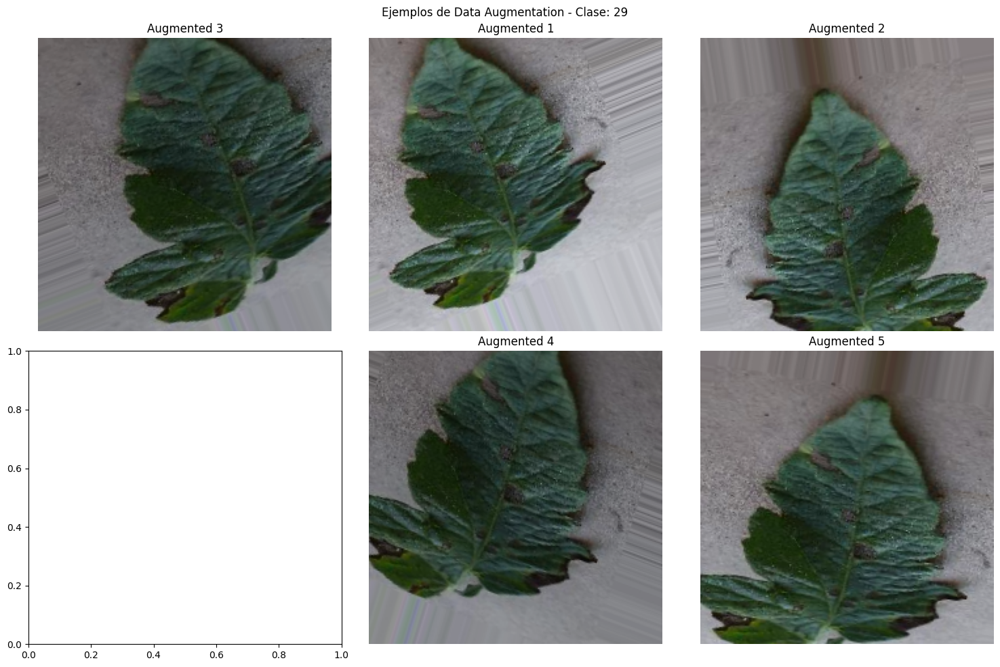


Ejemplos para clase: 19


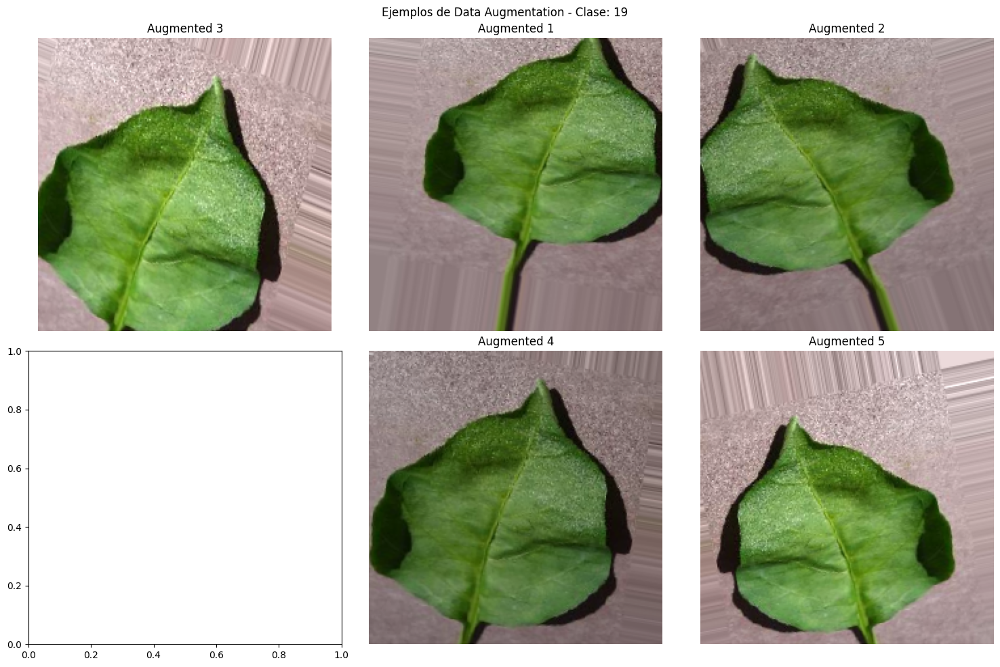


✅ ESTRATEGIA COMPLETADA EXITOSAMENTE


In [ ]:
# 3. Ejecutar estrategia completa (recomendado)
final_counts = ejecutar_estrategia_completa(
    train_dir=TRAIN_DIR,
    output_dir=BALANCED_DIR,
    strategy='auto',  # 'auto', 'max', 'mean', o 'custom'
    target_images=None,  # Solo si usas strategy='custom'
    visualizar_ejemplos=True
)


## Modelado VGG16

In [ ]:
project_base_path = f"/content/"
TRAIN_DIR = f"{project_base_path}/splitted/train"
TEST_DIR = f"{project_base_path}/balanced_dataset/train" # usamos el nuevo dataset de train balanceado
print(f"Looking for training data in: {TRAIN_DIR}")
print(f"Looking for test data in: {TEST_DIR}")

train_dataset = image_dataset_from_directory(
    TRAIN_DIR,
    label_mode='categorical',         #  CAMBIO multiclase
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    shuffle=True
)

test_dataset = image_dataset_from_directory(
    TEST_DIR,
    label_mode='categorical',         #  CAMBIO multiclase
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    shuffle=False
)

class_names = train_dataset.class_names
print(f"Classes found: {class_names}")
idx_to_label = dict(enumerate(class_names))  # útil para visualización posterior

# Aplicar transformaciones
train_ds = prepare_dataset(train_dataset, augment=True)
test_ds = prepare_dataset(test_dataset)
print("Data pipelines created and optimized.")

Looking for training data in: /content//splitted/train
Looking for test data in: /content//balanced_dataset/train
Found 43444 files belonging to 38 classes.
Found 59909 files belonging to 38 classes.
Classes found: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Data pipelines created and optimized.


In [ ]:
class CustomLogger(tf.keras.callbacks.Callback):
    def __init__(self, epochs):
        super().__init__()
        self.epochs = epochs

    def on_epoch_end(self, epoch, logs=None):
        print(
            f"Epoch {epoch + 1}/{self.epochs} - "
            f"Train Loss: {logs.get('loss'):.4f} | "
            f"Val Loss: {logs.get('val_loss'):.4f} | "
            f"Train Acc: {logs.get('accuracy'):.4f} | "
            f"Val Acc: {logs.get('val_accuracy'):.4f}"
        )


In [ ]:
print("\n--- Step 2: Building the Model ---")
model2 = build_vgg_model(NUM_CLASSES, FINE_TUNE_AT, INPUT_SHAPE)

model2.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE),
    loss='categorical_crossentropy',        # CAMBIO multiclase, ESTAN CON ONEHOTENCODER
    metrics=['accuracy']
)

model2.summary()


--- Step 2: Building the Model ---


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cast_4 (Cast)                   │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 38)             │         9,766 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 14,855,782 (56.67 MB)

 Trainable params: 7,220,518 (27.54 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [ ]:
checkpoint = ModelCheckpoint(
    MODEL_PATH, monitor='val_accuracy', save_best_only=True, verbose=1)

early_stop = EarlyStopping(
    monitor='val_loss', patience=5, restore_best_weights=True)

custom_logger = CustomLogger(epochs=EPOCHS)

history_keras = model2.fit(
    train_ds,
    epochs=EPOCHS,
    validation_data=test_ds,
    callbacks=[checkpoint, early_stop, custom_logger],
    verbose=0
)

history_compatible = {
    "train_loss": history_keras.history.get('loss', []),
    "test_loss": history_keras.history.get('val_loss', []),
    "train_acc": history_keras.history.get('accuracy', []),
    "test_acc": history_keras.history.get('val_accuracy', [])
}


Epoch 1: val_accuracy improved from -inf to 0.56971, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 1/30 - Train Loss: 2.4510 | Val Loss: 2.1886 | Train Acc: 0.4552 | Val Acc: 0.5697

Epoch 2: val_accuracy improved from 0.56971 to 0.70432, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 2/30 - Train Loss: 1.2120 | Val Loss: 1.5253 | Train Acc: 0.7520 | Val Acc: 0.7043

Epoch 3: val_accuracy improved from 0.70432 to 0.75349, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 3/30 - Train Loss: 0.9281 | Val Loss: 1.3350 | Train Acc: 0.8231 | Val Acc: 0.7535

Epoch 4: val_accuracy improved from 0.75349 to 0.76746, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 4/30 - Train Loss: 0.7879 | Val Loss: 1.2669 | Train Acc: 0.8609 | Val Acc: 0.7675

Epoch 5: val_accuracy improved from 0.76746 to 0.77840, saving model to vgg_fine_tuned_best_multiclass.keras
Epoch 5/30 - Train Loss: 0.7148 | Val Loss: 1.2305 | Train Acc: 0.8789 | Val Acc: 0.7784

Epoch 6

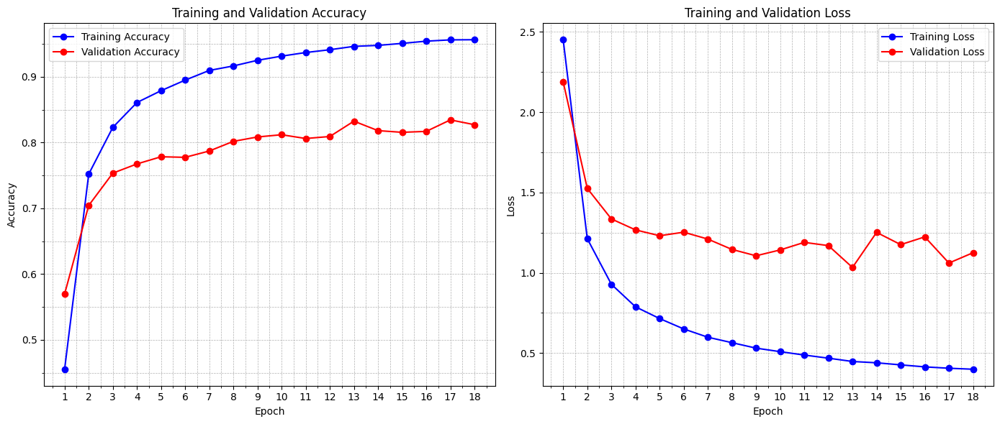

In [ ]:
# Ejecutar
plot_training_history(history_compatible)

Cargando modelo...
Modelo cargado exitosamente
Buscando imágenes en: /content/splitted/test
Clases esperadas: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '4', '5', '6', '7', '8', '9']
Clase '0': 126 imágenes encontradas
Clase '1': 124 imágenes encontradas
Clase '10': 232 imágenes encontradas
Clase '11': 236 imágenes encontradas
Clase '12': 277 imágenes encontradas
Clase '13': 215 imágenes encontradas
Clase '14': 85 imágenes encontradas
Clase '15': 1102 imágenes encontradas
Clase '16': 460 imágenes encontradas
Clase '17': 72 imágenes encontradas
Clase '18': 199 imágenes encontradas
Clase '19': 296 imágenes encontradas
Clase '2': 55 imágenes encontradas
Clase '20': 200 imágenes encontradas
Clase '21': 200 imágenes encontradas
Clase '22': 30 imágenes encontradas
Clase '23': 74 imágenes encontradas
Clase '24': 1018 imágenes encontradas
Clase '25':

Procesando imágenes: 100%|██████████| 679/679 [01:31<00:00,  7.44it/s]


Predicciones completadas: 10861 imágenes procesadas


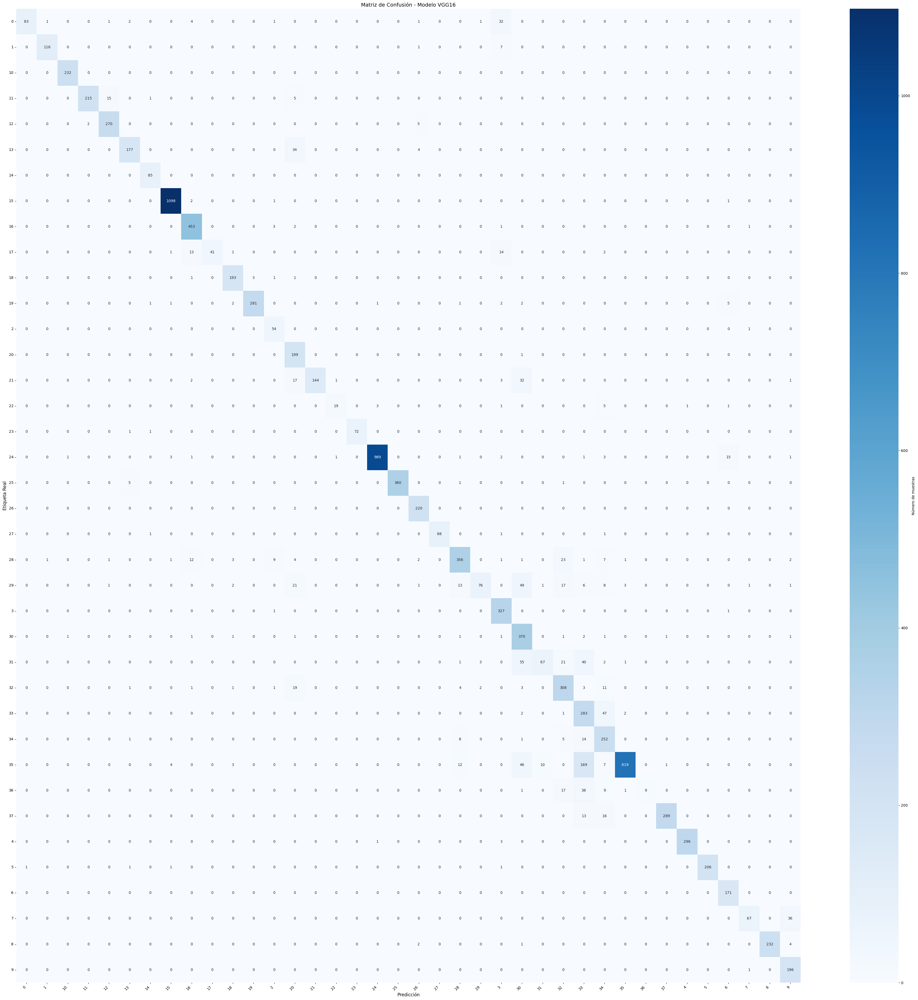


Accuracy total: 0.8943 (89.43%)

REPORTE DE CLASIFICACIÓN DETALLADO
              precision    recall  f1-score   support

           0     0.9881    0.6587    0.7905       126
           1     0.9831    0.9355    0.9587       124
          10     0.9915    1.0000    0.9957       232
          11     0.9908    0.9110    0.9492       236
          12     0.9375    0.9747    0.9558       277
          13     0.9415    0.8233    0.8784       215
          14     0.9551    1.0000    0.9770        85
          15     0.9901    0.9964    0.9932      1102
          16     0.9245    0.9848    0.9537       460
          17     1.0000    0.5694    0.7257        72
          18     0.9369    0.9698    0.9531       199
          19     0.9894    0.9493    0.9690       296
           2     0.7606    0.9818    0.8571        55
          20     0.6525    0.9950    0.7881       200
          21     1.0000    0.7200    0.8372       200
          22     0.9048    0.6333    0.7451        30
          23

In [ ]:
# # Opción 1: Si ya tienes el modelo cargado
#mostrar_matriz_y_reporte_vgg(best_model, TEST_DIR, class_names)
#
# # Opción 2: Evaluar desde archivo guardado
model, y_true, y_pred, cm = evaluar_modelo_completo(
     '/content/vgg_fine_tuned_best_multiclass.keras', '/content/splitted/test', class_names)

# Comparacion

In [1]:
import matplotlib.pyplot as plt
import pandas as pd

In [2]:
# Datos
scores_data = {
    "Clase": [str(i) for i in range(38)],
    "Precision_con": [
        0.9881, 0.9831, 0.7606, 0.8258, 0.9966, 1.0000, 0.8814, 0.9437, 1.0000, 0.8099,
        0.9915, 0.9908, 0.9375, 0.9415, 0.9551, 0.9901, 0.9245, 1.0000, 0.9369, 0.9894,
        0.6525, 1.0000, 0.9048, 1.0000, 0.9950, 1.0000, 0.9322, 1.0000, 0.8945, 0.9268,
        0.6560, 0.8590, 0.7817, 0.4965, 0.6792, 0.9903, 1.0000, 0.9931
    ],
    "Precision_sin": [
        0.9612, 0.9508, 0.7333, 0.8458, 0.9900, 0.9810, 0.9716, 0.9022, 0.9916, 0.8815,
        1.0000, 0.9938, 0.8006, 0.8607, 0.9655, 1.0000, 0.7839, 1.0000, 1.0000, 0.9666,
        0.7386, 0.9242, 0.9200, 0.9841, 0.9922, 0.9890, 0.9910, 0.9362, 0.9314, 0.8689,
        0.5414, 0.8276, 0.8528, 0.5885, 0.7164, 0.9877, 1.0000, 0.9799
    ],
    "Recall_con": [
        0.6587, 0.9355, 0.9818, 0.9939, 0.9867, 0.9810, 1.0000, 0.6505, 0.9707, 0.9949,
        1.0000, 0.9110, 0.9747, 0.8233, 1.0000, 0.9964, 0.9848, 0.5694, 0.9698, 0.9493,
        0.9950, 0.7200, 0.6333, 0.9730, 0.9715, 0.9809, 0.9910, 0.9670, 0.8376, 0.3800,
        0.9686, 0.3526, 0.8701, 0.8448, 0.8968, 0.7647, 0.1200, 0.9088
    ],
    "Recall_sin": [
        0.7857, 0.9355, 1.0000, 1.0000, 0.9867, 0.9857, 1.0000, 0.8058, 0.9916, 0.9442,
        1.0000, 0.6780, 1.0000, 0.9767, 0.9882, 0.9973, 0.9935, 0.2917, 0.7739, 0.9764,
        0.9750, 0.9150, 0.7667, 0.8378, 0.9961, 0.9837, 0.9955, 0.9670, 0.6071, 0.2650,
        0.9764, 0.2526, 0.7853, 0.9134, 0.8541, 0.8217, 0.1200, 0.9182
    ],
    "F1_con": [
        0.7905, 0.9587, 0.8571, 0.9021, 0.9916, 0.9904, 0.9370, 0.7701, 0.9851, 0.8929,
        0.9957, 0.9492, 0.9558, 0.8784, 0.9770, 0.9932, 0.9537, 0.7257, 0.9531, 0.9690,
        0.7881, 0.8372, 0.7451, 0.9863, 0.9831, 0.9904, 0.9607, 0.9832, 0.8651, 0.5390,
        0.7822, 0.5000, 0.8235, 0.6254, 0.7730, 0.8630, 0.2143, 0.9491
    ],
    "F1_sin": [
        0.8646, 0.9431, 0.8462, 0.9164, 0.9883, 0.9834, 0.9856, 0.8513, 0.9916, 0.9118,
        1.0000, 0.8060, 0.8892, 0.9150, 0.9767, 0.9986, 0.8763, 0.4516, 0.8725, 0.9714,
        0.8405, 0.9196, 0.8364, 0.9051, 0.9941, 0.9863, 0.9933, 0.9514, 0.7350, 0.4061,
        0.6965, 0.3871, 0.8176, 0.7158, 0.7792, 0.8970, 0.2143, 0.9481
    ]
}

In [3]:
df = pd.DataFrame(scores_data)
df = df.sort_values(by="Clase")

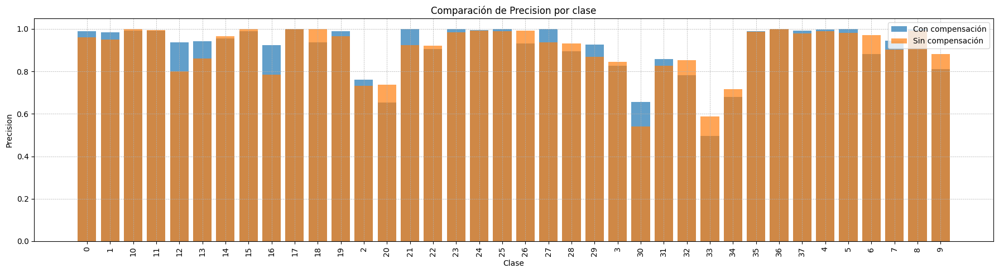

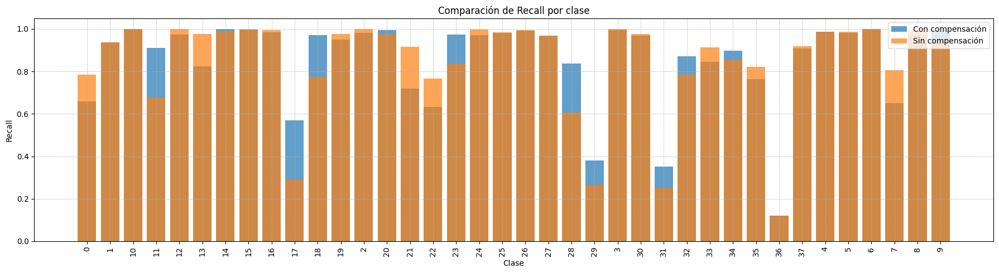

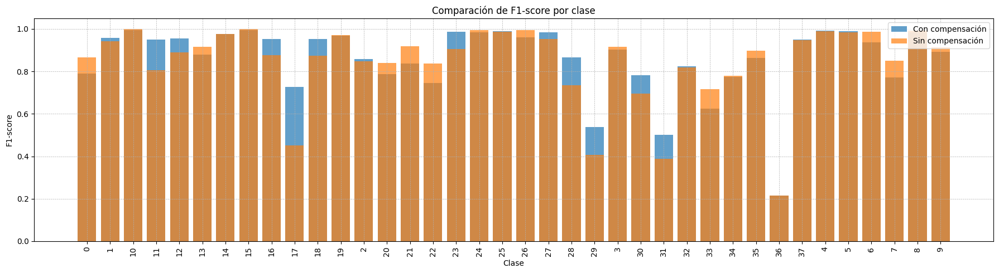

In [5]:
# Listas de métricas y nombres correctos de columnas
metrics = [("Precision", "Precision_con", "Precision_sin"),
           ("Recall", "Recall_con", "Recall_sin"),
           ("F1-score", "F1_con", "F1_sin")]

for title, col_con, col_sin in metrics:
    plt.figure(figsize=(18, 5))
    plt.bar(df["Clase"], df[col_con], label="Con compensación", alpha=0.7)
    plt.bar(df["Clase"], df[col_sin], label="Sin compensación", alpha=0.7)
    plt.xticks(rotation=90)
    plt.title(f"Comparación de {title} por clase")
    plt.xlabel("Clase")
    plt.ylabel(title)
    plt.ylim(0, 1.05)
    plt.grid(True, linestyle='--', linewidth=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


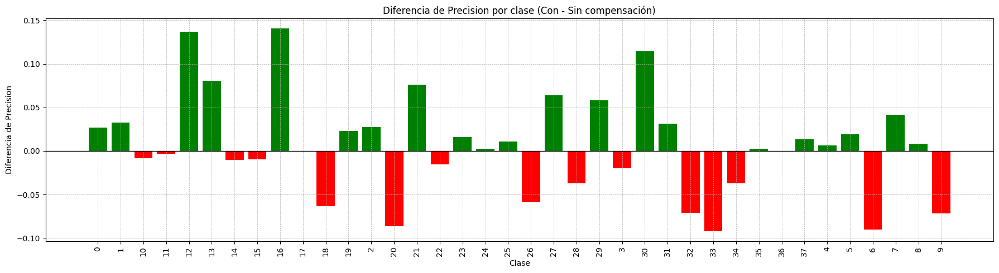

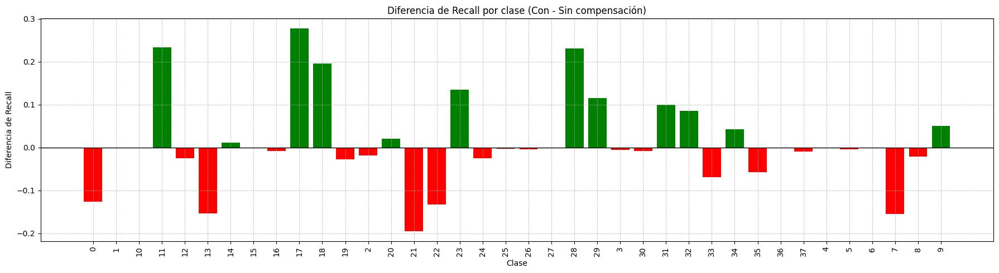

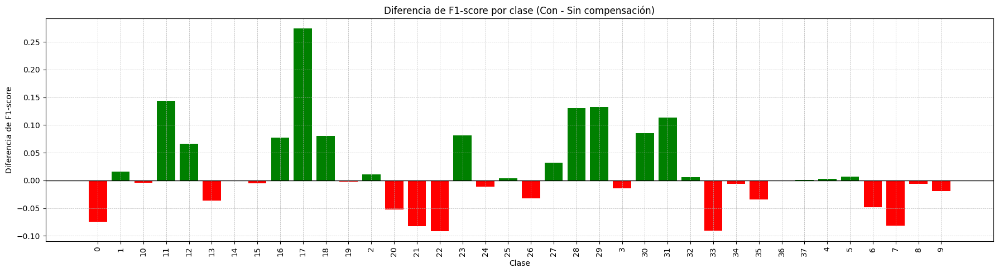

In [6]:
# Iterar por métrica
for metric_name, col_con, col_sin in metrics:
    diferencia = df[col_con] - df[col_sin]

    plt.figure(figsize=(18, 5))
    colores = ['green' if d > 0 else 'red' for d in diferencia]

    plt.bar(df["Clase"], diferencia, color=colores)
    plt.axhline(0, color='black', linewidth=1)
    plt.title(f"Diferencia de {metric_name} por clase (Con - Sin compensación)")
    plt.xlabel("Clase")
    plt.ylabel(f"Diferencia de {metric_name}")
    plt.xticks(rotation=90)
    plt.grid(True, linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()

In [7]:
clases_minoritarias = {
    0, 1, 2, 6, 7, 9, 14, 17, 18, 20, 21, 22, 23, 27, 29, 31, 36
}

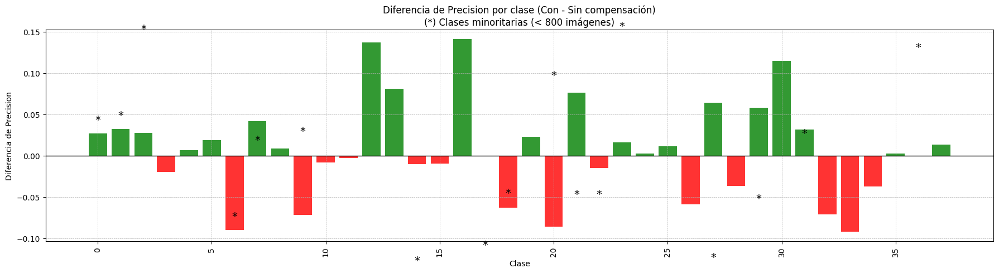

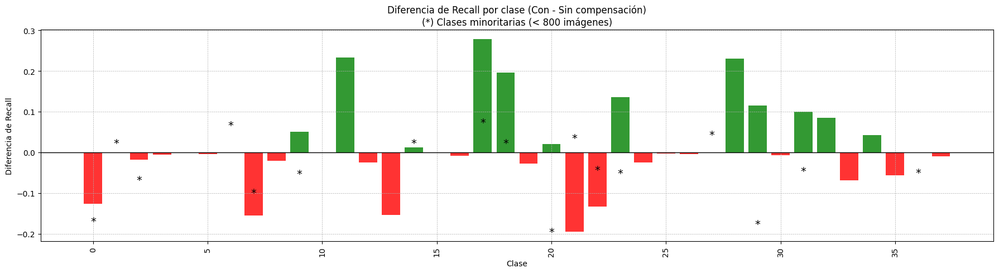

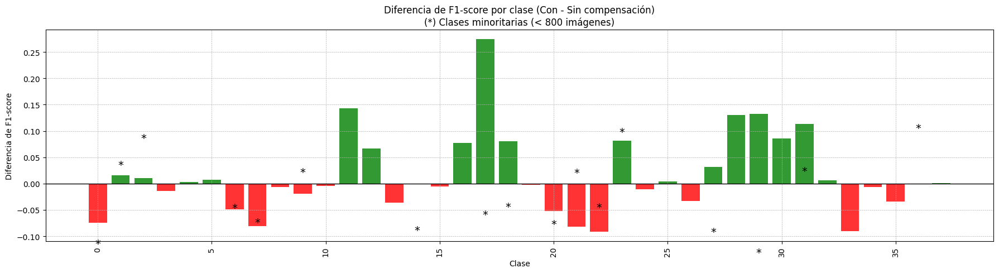

In [10]:
for metric_name, col_con, col_sin in metrics:
    diferencia = df[col_con] - df[col_sin]
    clases = df["Clase"].astype(int)

    colores = ['green' if diff > 0 else 'red' for diff in diferencia]

    plt.figure(figsize=(18, 5))
    bars = plt.bar(clases, diferencia, color=colores, alpha=0.8)
    plt.axhline(0, color='black', linewidth=1)

    # Asterisco sobre clases minoritarias
    for i, clase in enumerate(clases):
        if clase in clases_minoritarias:
            y = diferencia[i]
            offset = 0.01 if y >= 0 else -0.03
            plt.text(clase, y + offset, '*', ha='center', va='bottom' if y >= 0 else 'top', fontsize=14, color='black')

    plt.title(f"Diferencia de {metric_name} por clase (Con - Sin compensación)\n(*) Clases minoritarias (< 800 imágenes)")
    plt.xlabel("Clase")
    plt.ylabel(f"Diferencia de {metric_name}")
    plt.xticks(rotation=90)
    plt.grid(True, linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()

In [11]:
le = {0: 'Apple___Apple_scab',
 1: 'Apple___Black_rot',
 2: 'Apple___Cedar_apple_rust',
 3: 'Apple___healthy',
 4: 'Blueberry___healthy',
 5: 'Cherry_(including_sour)___Powdery_mildew',
 6: 'Cherry_(including_sour)___healthy',
 7: 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 8: 'Corn_(maize)___Common_rust_',
 9: 'Corn_(maize)___Northern_Leaf_Blight',
 10: 'Corn_(maize)___healthy',
 11: 'Grape___Black_rot',
 12: 'Grape___Esca_(Black_Measles)',
 13: 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 14: 'Grape___healthy',
 15: 'Orange___Haunglongbing_(Citrus_greening)',
 16: 'Peach___Bacterial_spot',
 17: 'Peach___healthy',
 18: 'Pepper,_bell___Bacterial_spot',
 19: 'Pepper,_bell___healthy',
 20: 'Potato___Early_blight',
 21: 'Potato___Late_blight',
 22: 'Potato___healthy',
 23: 'Raspberry___healthy',
 24: 'Soybean___healthy',
 25: 'Squash___Powdery_mildew',
 26: 'Strawberry___Leaf_scorch',
 27: 'Strawberry___healthy',
 28: 'Tomato___Bacterial_spot',
 29: 'Tomato___Early_blight',
 30: 'Tomato___Late_blight',
 31: 'Tomato___Leaf_Mold',
 32: 'Tomato___Septoria_leaf_spot',
 33: 'Tomato___Spider_mites Two-spotted_spider_mite',
 34: 'Tomato___Target_Spot',
 35: 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 36: 'Tomato___Tomato_mosaic_virus',
 37: 'Tomato___healthy'}

In [12]:
def generar_reporte_comparativo(df, class_dict):
    metrics = [("Precision", "Precision_con", "Precision_sin"),
               ("Recall", "Recall_con", "Recall_sin"),
               ("F1-score", "F1_con", "F1_sin")]

    for metric_name, col_con, col_sin in metrics:
        print(f"\n=== {metric_name.upper()} ===")
        mejoraron = []
        empeoraron = []

        for idx, row in df.iterrows():
            clase = int(row['Clase'])
            nombre_clase = class_dict[clase]
            diferencia = row[col_con] - row[col_sin]

            if diferencia > 0:
                mejoraron.append((nombre_clase, diferencia))
            elif diferencia < 0:
                empeoraron.append((nombre_clase, diferencia))

        print(f"\n→ Clases que MEJORARON {metric_name} con compensación:")
        for nombre, diff in sorted(mejoraron, key=lambda x: -x[1]):
            print(f"  + {nombre:<55} Δ = {diff:.4f}")

        print(f"\n→ Clases que EMPEORARON {metric_name} con compensación:")
        for nombre, diff in sorted(empeoraron, key=lambda x: x[1]):
            print(f"  - {nombre:<55} Δ = {diff:.4f}")


In [13]:
generar_reporte_comparativo(df, le)



=== PRECISION ===

→ Clases que MEJORARON Precision con compensación:
  + Peach___Bacterial_spot                                  Δ = 0.1406
  + Grape___Esca_(Black_Measles)                            Δ = 0.1369
  + Tomato___Late_blight                                    Δ = 0.1146
  + Grape___Leaf_blight_(Isariopsis_Leaf_Spot)              Δ = 0.0808
  + Potato___Late_blight                                    Δ = 0.0758
  + Strawberry___healthy                                    Δ = 0.0638
  + Tomato___Early_blight                                   Δ = 0.0579
  + Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot      Δ = 0.0415
  + Apple___Black_rot                                       Δ = 0.0323
  + Tomato___Leaf_Mold                                      Δ = 0.0314
  + Apple___Cedar_apple_rust                                Δ = 0.0273
  + Apple___Apple_scab                                      Δ = 0.0269
  + Pepper,_bell___healthy                                  Δ = 0.0228
  + Ch

In [14]:
def reporte_mejoras_minoritarias(df, class_dict, clases_minoritarias):
    print("\n===== REPORTE DE CLASES MINORITARIAS =====\n")
    metrics = [("Precision", "Precision_con", "Precision_sin"),
               ("Recall", "Recall_con", "Recall_sin"),
               ("F1-score", "F1_con", "F1_sin")]

    for metric_name, col_con, col_sin in metrics:
        print(f"\n>>> {metric_name.upper()} <<<")
        mejoraron = []
        empeoraron = []
        iguales = []

        for clase_id in clases_minoritarias:
            fila = df[df["Clase"] == str(clase_id)].iloc[0]
            nombre_clase = class_dict[clase_id]
            diferencia = fila[col_con] - fila[col_sin]

            if diferencia > 0:
                mejoraron.append((nombre_clase, diferencia))
            elif diferencia < 0:
                empeoraron.append((nombre_clase, diferencia))
            else:
                iguales.append(nombre_clase)

        print("\n→ Mejoraron:")
        for nombre, diff in sorted(mejoraron, key=lambda x: -x[1]):
            print(f"  + {nombre:<55} Δ = {diff:.4f}")

        print("\n→ Empeoraron:")
        for nombre, diff in sorted(empeoraron, key=lambda x: x[1]):
            print(f"  - {nombre:<55} Δ = {diff:.4f}")

        if iguales:
            print("\n→ Sin cambios:")
            for nombre in iguales:
                print(f"    = {nombre}")


In [15]:
reporte_mejoras_minoritarias(df, le, clases_minoritarias)


===== REPORTE DE CLASES MINORITARIAS =====


>>> PRECISION <<<

→ Mejoraron:
  + Potato___Late_blight                                    Δ = 0.0758
  + Strawberry___healthy                                    Δ = 0.0638
  + Tomato___Early_blight                                   Δ = 0.0579
  + Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot      Δ = 0.0415
  + Apple___Black_rot                                       Δ = 0.0323
  + Tomato___Leaf_Mold                                      Δ = 0.0314
  + Apple___Cedar_apple_rust                                Δ = 0.0273
  + Apple___Apple_scab                                      Δ = 0.0269
  + Raspberry___healthy                                     Δ = 0.0159

→ Empeoraron:
  - Cherry_(including_sour)___healthy                       Δ = -0.0902
  - Potato___Early_blight                                   Δ = -0.0861
  - Corn_(maize)___Northern_Leaf_Blight                     Δ = -0.0716
  - Pepper,_bell___Bacterial_spot                   